<a href="https://colab.research.google.com/github/frnocentini/brain-tumor-object-dectection/blob/main/ResNet101V2_1exp.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [13]:
%cd '/content/drive/MyDrive/dataset brain tumor/dataset' 


/content/drive/MyDrive/dataset brain tumor/dataset


In [ ]:
!unzip 'axial_t1wce_2_class' -d '/dataset unzipped'

In [ ]:
!unzip 'coronal_t1wce_2_class' -d '/dataset unzipped'

In [ ]:
!unzip 'sagittal_t1wce_2_class' -d '/dataset unzipped' 

In [7]:
# Data Manipulation
import numpy as np
import pandas as pd
import os
# Visualization/Image Processing
import cv2
import matplotlib.pyplot as plt
from tqdm import tqdm
# Machine Learning
import tensorflow as tf
from tensorflow.keras.layers import Conv2D, Input, BatchNormalization, Flatten, MaxPool2D, Dense, Activation
from PIL import Image
# Other
from pathlib import Path
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split
from tensorflow import keras
from tensorflow.keras.applications import ResNet101V2
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.models import Model
import xml.etree.ElementTree as ET
from tensorflow.keras.models import Sequential
from tensorflow.keras import layers
import imutils

In [17]:
%cd '/dataset unzipped'

/dataset unzipped


In [20]:
def crop_brain_contour(image, plot=False):
    
    # Convert the image to grayscale, and blur it slightly
    
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    gray = cv2.GaussianBlur(gray, (5, 5), 0)

    # Threshold the image
    thresh = cv2.threshold(gray, 30, 255, cv2.THRESH_BINARY)[1]
    
    # Find contours in thresholded image, then grab the largest one
    cnts = cv2.findContours(thresh.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    cnts = imutils.grab_contours(cnts)
    c = max(cnts, key=cv2.contourArea)
    

    # Find the extreme points
    extLeft = tuple(c[c[:, :, 0].argmin()][0])
    extRight = tuple(c[c[:, :, 0].argmax()][0])
    extTop = tuple(c[c[:, :, 1].argmin()][0])
    extBot = tuple(c[c[:, :, 1].argmax()][0])
    
    # crop new image out of the original image using the four extreme points (left, right, top, bottom)
    new_image = image[extTop[1]:extBot[1], extLeft[0]:extRight[0]]            

    if plot:
        plt.figure()

        plt.subplot(1, 2, 1)
        plt.imshow(image)
        
        plt.tick_params(axis='both', which='both', 
                        top=False, bottom=False, left=False, right=False,
                        labelbottom=False, labeltop=False, labelleft=False, labelright=False)
        
        plt.title('Original Image')
            
        plt.subplot(1, 2, 2)
        plt.imshow(new_image)

        plt.tick_params(axis='both', which='both', 
                        top=False, bottom=False, left=False, right=False,
                        labelbottom=False, labeltop=False, labelleft=False, labelright=False)

        plt.title('Cropped Image')
        
        plt.show()
    
    return new_image,extLeft,extRight,extTop,extBot

In [21]:
#Hyperparameters 
image_size = 224
BATCH_SIZE = 16
hyper_channels = 3

In [24]:
#Bounding box with one tumor
#Define the name of the 3 classes of MRI
lab = ['axial_t1wce_2_class','coronal_t1wce_2_class', 'sagittal_t1wce_2_class']
#Define the list of images for the training 
X_train = []

count = 0;
#Lists of coordinates for resizing bounding box
temp_array  = []
extLeft_coords_x = []
extLeft_coords_y = []
extRight_coords_x = []
extRight_coords_y = []
extTop_coords_x = []
extTop_coords_y = []
extBot_coords_x = []
extBot_coords_y = []
image_width = []
image_height = []


extLeft_coords_x_test = []
extLeft_coords_y_test = []
extRight_coords_x_test = []
extRight_coords_y_test = []
extTop_coords_x_test = []
extTop_coords_y_test = []
extBot_coords_x_test = []
extBot_coords_y_test = []
images_width_test = []
images_height_test = []
width_new_im = []
height_new_im = []
traslazione_x_test = []
traslazione_y_test = []


#Loading training images
for i in lab:
    folderPath = os.path.join('./',i,'images','train')
    for j in sorted(os.listdir(folderPath)):
        #load the image
        img = cv2.imread(os.path.join(folderPath,j))
        image_width.append(img.shape[1])
        image_height.append(img.shape[0])
        #crop the brain and ignore the unnecessary rest part of the image
        image,extLeft,extRight,extTop,extBot = crop_brain_contour(img,False)
        extLeft_coords_x.append(extLeft[0])
        extLeft_coords_y.append(extLeft[1])
        extRight_coords_x.append(extRight[0])
        extRight_coords_y.append(extRight[1])
        extTop_coords_x.append(extTop[0])
        extTop_coords_y.append(extTop[1])
        extBot_coords_x.append(extBot[0])
        extBot_coords_y.append(extBot[1])
        # resize image
        image = cv2.resize(image, dsize=(image_size, image_size), interpolation=cv2.INTER_CUBIC)
        X_train.append(image)

#Load train bounding box labels
image_index = 0
#Define the list of bb coordinates for the training images
bb_list = []
#List used to duplicate images with two bounding box
duplicate_img = []
for i in lab:
    labelsPath = os.path.join('./',i,'labels','train')
    for j in sorted(os.listdir(labelsPath)):
        with open(os.path.join(labelsPath,j), encoding="utf-8") as f:
            lbls_array = []
            for line in f:
                num = list(map(float,line.split(" ")))
                temp_array = []
                for k in num:
                    temp_array.append(k)
                temp_array.pop(0)
                 
                temp_array[0] = temp_array[0]*image_width[count] #centro x immagine originale
                temp_array[0] = temp_array[0]-extLeft_coords_x[count]
                temp_array[0] = (temp_array[0]/(extRight_coords_x[count]-extLeft_coords_x[count]))*image_size
                
                temp_array[1] = temp_array[1]*image_height[count]
                temp_array[1] = temp_array[1]-extTop_coords_y[count]
                temp_array[1] = (temp_array[1]/(extBot_coords_y[count]-extTop_coords_y[count]))*image_size
                
                temp_array[2] = temp_array[2]*(image_width[count])
                temp_array[2] = (temp_array[2]/(extRight_coords_x[count]-extLeft_coords_x[count]))*image_size
                
                
                temp_array[3] = temp_array[3]*(image_height[count])
                temp_array[3] = (temp_array[3]/(extBot_coords_y[count]-extTop_coords_y[count]))*image_size                 
            
                lbls_array.append(temp_array)


            bb_list.append(temp_array)
            duplicate_img.append(lbls_array)
            image_index += 1
            count += 1

#Code to duplicate images with two bounding boxes
print('Dimension of the train list before image duplication:')
print('X_train: ', len(X_train))
print('bb_list: ', len(bb_list))

for i in range(len(X_train)):
  if(len(duplicate_img[i]) == 2):
    X_train.append(X_train[i])
    bb_list.append(duplicate_img[i][0])  #Inside bb_list the second label has already been put, now we insert the first label
bb_train = np.zeros((len(X_train),4))

for j in range(len(bb_list)):
  bb_train[j] = np.array([bb_list[j]])

#Dimension of the list after image duplication:
print('Dimension of the train list after image duplication:')
print('X_train: ', len(X_train))
print('bb_train: ', len(bb_train))


#Load test images
X_test = []
for i in lab:
    folderPath = os.path.join('./',i,'images','test')
    for j in sorted(os.listdir(folderPath)):
        #load the image
        img = cv2.imread(os.path.join(folderPath,j))
        images_width_test.append(img.shape[1])
        images_height_test.append(img.shape[0])
        # crop the brain and ignore the unnecessary rest part of the image
        image_test,extLeft_test,extRight_test,extTop_test,extBot_test = crop_brain_contour(img,False)
        extLeft_coords_x_test.append(extLeft_test[0])
        extLeft_coords_y_test.append(extLeft_test[1])
        extRight_coords_x_test.append(extRight_test[0])
        extRight_coords_y_test.append(extRight_test[1])
        extTop_coords_x_test.append(extTop_test[0])
        extTop_coords_y_test.append(extTop_test[1])
        extBot_coords_x_test.append(extBot_test[0])
        extBot_coords_y_test.append(extBot_test[1])
        # resize image
        image_test = cv2.resize(image_test, dsize=(image_size, image_size), interpolation=cv2.INTER_CUBIC)
        X_test.append(image_test)

#Load the bounding box labels for testing
image_index = 0
count_test = 0;
bb_list = []
duplicate_img = []
for i in lab:
    labelsPath = os.path.join('./',i,'labels','test')
    for j in sorted(os.listdir(labelsPath)):
        with open(os.path.join(labelsPath,j), encoding="utf-8") as f:
            lbls_array = []
            for line in f:
                num = list(map(float,line.split(" ")))
                temp_array = []
                for k in num:
                    temp_array.append(k)
                temp_array.pop(0)
                
                #rescaling the bounding box to the correct position after crop
                temp_array[0] = temp_array[0]*images_width_test[count_test] #centro x immagine originale
                temp_array[0] = temp_array[0]-extLeft_coords_x_test[count_test]
                temp_array[0] = (temp_array[0]/(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test]))*image_size
                
                temp_array[1] = temp_array[1]*images_height_test[count_test]
                temp_array[1] = temp_array[1]-extTop_coords_y_test[count_test]
                temp_array[1] = (temp_array[1]/(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test]))*image_size
                
                temp_array[2] = temp_array[2]*(images_width_test[count_test])
                temp_array[2] = (temp_array[2]/(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test]))*image_size
                
                
                temp_array[3] = temp_array[3]*(images_height_test[count_test])
                temp_array[3] = (temp_array[3]/(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test]))*image_size                 
            
                lbls_array.append(temp_array)


            bb_list.append(temp_array)
            duplicate_img.append(lbls_array)
            image_index += 1
            count_test += 1

#Code to duplicate images with two bounding boxes
print('Dimension of the test list before image duplication:')
print('X_test: ', len(X_test))
print('bb_list: ', len(bb_list))

for i in range(len(X_test)):
  if(len(duplicate_img[i]) == 2):
    X_test.append(X_test[i])
    bb_list.append(duplicate_img[i][0]) #Inside bb_list the second label has already been put, now we insert the first label

bb_test = np.zeros((len(X_test),4))

for j in range(len(bb_test)):
  bb_test[j] = np.array([bb_list[j]])

#Dimensione delle liste dopo la duplicazione delle immagini:
print('Dimension of the test list after image duplication:')
print('X_test: ', len(X_test))
print('bb_test: ', len(bb_test))


Dimension of the train list before image duplication:
X_train:  878
bb_list:  878
Dimension of the train list after image duplication:
X_train:  919
bb_train:  919
Dimension of the test list before image duplication:
X_test:  223
bb_list:  223
Dimension of the test list after image duplication:
X_test:  237
bb_test:  237


In [25]:
#prepare dataset 
train_dataset = ImageDataGenerator()
val_dataset = ImageDataGenerator()
test_dataset = ImageDataGenerator()

In [26]:
#array conversion
X_train = np.array(X_train)
X_test = np.array(X_test)

In [27]:
#Shuffle of the train dataset
X_train, bb_train = shuffle(X_train, bb_train)

In [28]:
#Validation set creation
X_train, X_val, bb_train, bb_val = train_test_split(X_train, bb_train, test_size = 0.1, shuffle = False)

In [29]:
#Creation of the three data generator datasets to feed the model with batches of data during the training process
train_dataset = train_dataset.flow(X_train, bb_train, batch_size = BATCH_SIZE)
val_dataset = val_dataset.flow(X_val, bb_val, batch_size = BATCH_SIZE)
test_dataset = test_dataset.flow(X_test, bb_test, batch_size = BATCH_SIZE)

In [31]:
#Function to define the IoU metrics
def raw_iou(y_true, y_pred):
    results = []
    for i in range(0,y_true.shape[0]):

        #define the true and predicted coordinates (height and width)
        boxTrue_width = y_true[i,2]
        boxTrue_height = y_true[i,3]
        x_boxTrue_tleft = y_true[i,0]-boxTrue_width/2 
        y_boxTrue_tleft = y_true[i,1]-boxTrue_height/2

        #Define the bb true area 
        area_boxTrue = (boxTrue_width * boxTrue_height)

        # boxPred
        boxPred_width = y_pred[i,2]
        boxPred_height = y_pred[i,3]
        x_boxPred_tleft = y_pred[i,0]-boxPred_width/2  
        y_boxPred_tleft = y_pred[i,1]-boxPred_height/2

        #Define the bb predicted area 
        area_boxPred = (boxPred_width * boxPred_height)


        # calculate the bottom right coordinates for boxTrue and boxPred

        # boxTrue
        x_boxTrue_br = x_boxTrue_tleft + boxTrue_width
        y_boxTrue_br = y_boxTrue_tleft + boxTrue_height # Version 2 revision

        # boxPred
        x_boxPred_br = x_boxPred_tleft + boxPred_width
        y_boxPred_br = y_boxPred_tleft + boxPred_height # Version 2 revision


        # calculate the top left and bottom right coordinates for the intersection box, boxInt

        # boxIntersection - top left coords
        x_boxInt_tleft = np.max([x_boxTrue_tleft,x_boxPred_tleft])
        y_boxInt_tleft = np.max([y_boxTrue_tleft,y_boxPred_tleft]) # Version 2 revision

        # boxIntersection - bottom right coords
        x_boxInt_br = np.min([x_boxTrue_br,x_boxPred_br])
        y_boxInt_br = np.min([y_boxTrue_br,y_boxPred_br]) 

        # Calculate the area of boxInt, i.e. the area of the intersection 
        # between boxTrue and boxPred.
        # The np.max() function forces the intersection area to 0 if the boxes don't overlap.
        
        area_of_intersection = \
        np.max([0,(x_boxInt_br - x_boxInt_tleft)]) * np.max([0,(y_boxInt_br - y_boxInt_tleft)])
        
        #calculate the mean IoU for every image
        iou = np.mean(area_of_intersection / ((area_boxTrue + area_boxPred) - area_of_intersection)).astype(np.float32)

        results.append(iou)
    return np.mean(results)

# metric creation
def IoU(y_true, y_pred):
    iou = tf.numpy_function(raw_iou, [y_true, y_pred], tf.float32)
    return iou



In [ ]:
# Draw the predicted bounding boxes
def display_image(img, bbox_coords, pred_coords):
    if len(bbox_coords) == 4: #in red the real bounding box
        xmin, ymin, width, height = bbox_coords
        img = cv2.rectangle(img, (int(xmin-width/2), int(ymin-height/2)), (int(xmin+width/2), int(ymin+height/2)), (255, 0, 0), 1)
    if len(pred_coords) == 4: #in green the predicted bounding box
        xmin1, ymin1, width1, height1 = pred_coords
        img = cv2.rectangle(img, (int(xmin1-width1/2), int(ymin1-height1/2)), (int(xmin1+width1/2), int(ymin1+height1/2)), (0, 255, 0), 1)
    plt.imshow(img)
    plt.xticks([])
    plt.yticks([])

In [ ]:
#To test the model during training
def test_model(model):
    rand_index = np.random.randint(0, bb_test.shape[0])
    pred_bbox = model.predict(X_test)[rand_index]
    img_original = X_test[rand_index]
    img = img_original.copy()
    coords = bb_test[rand_index]
    
    display_image(img,bbox_coords = coords, pred_coords=pred_bbox)

def test(model):
    
    plt.figure(figsize=(15,7))
    for i in range(3):
        plt.subplot(1, 3, i + 1)
        test_model(model)    
    plt.show()

class ShowTestImages(tf.keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs=None):
        test(self.model)
        

In [ ]:
#change folder to create the folder for saving the model
%cd '../content/drive/MyDrive'
! mkdir  model_checkpoint_RESNET

/content/drive/MyDrive
mkdir: cannot create directory ‘model_checkpoint_RESNET’: File exists


In [ ]:
save_path = './model_checkpoint_RESNET/model_RESNET.h5'

In [33]:
#list of callbacks
callbacks_list = [
    keras.callbacks.ModelCheckpoint(
    filepath=save_path,
    monitor="val_IoU",
    verbose=1,
    mode="max",
    save_best_only=True
    ),
    tf.keras.callbacks.EarlyStopping(
    monitor="val_IoU",
    patience=20,
    verbose=0,
    mode="max",
    restore_best_weights=True,
    start_from_epoch=50,
),

    ShowTestImages()
]

NameError: ignored

In [32]:
#Tranfer Learning
resnet = ResNet101V2(weights='imagenet',include_top=False,input_shape=(image_size,image_size,hyper_channels))
#Fine tuning
model = resnet.output
model = tf.keras.layers.GlobalAveragePooling2D()(model)
model = tf.keras.layers.Dropout(rate=0.5)(model)
model = layers.Dense(256)(model)
model = tf.keras.layers.Dropout(rate=0.5)(model)
model = tf.keras.layers.Dense(4,name='bb_pred')(model)
model = tf.keras.models.Model(inputs=resnet.input, outputs = model)
model.summary()

171317808/171317808 [==============================] - 6s 0us/step
Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, 230, 230, 3)  0           ['input_1[0][0]']                
                                                                                                  
 conv1_conv (Conv2D)            (None, 112, 112, 64  9472        ['conv1_pad[0][0]']              
                                )                                                                 
                           

In [34]:
%cd '../../..'
%cd '/dataset unzipped'

/
/dataset unzipped


(224, 224, 3)
1/1 [==============================] - 0s 87ms/step


<ipython-input-36-109e207dd64e>:36: RuntimeWarning: invalid value encountered in true_divide
  x /= x.std ()


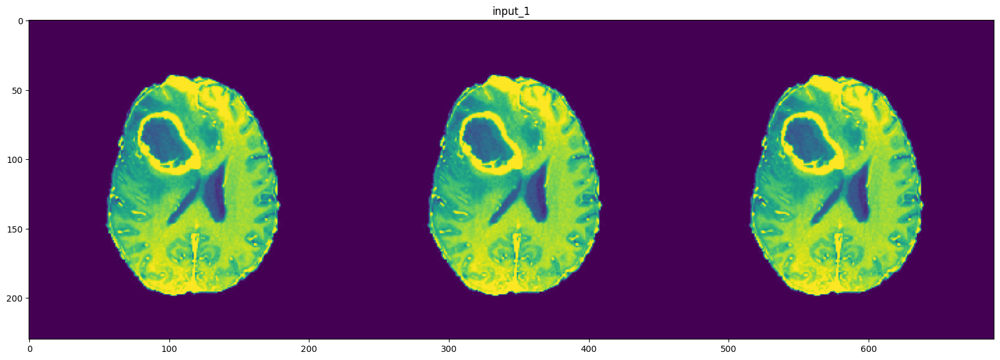

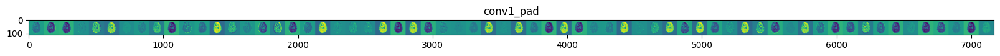

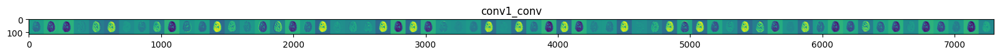

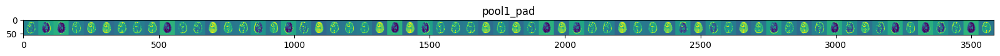

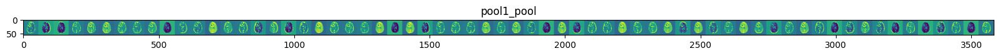

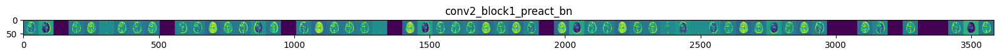

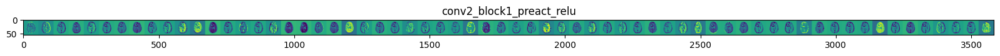

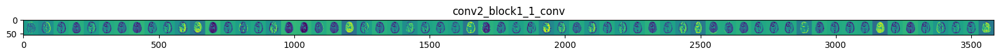

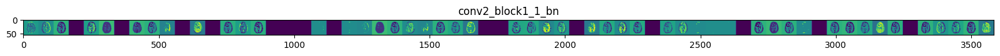

In [36]:
#plot the feature extraction for the first 10 layers of the neural network
from keras.models import Model
img_path='./axial_t1wce_2_class/images/train/00095_224.jpg' 
# Output= intermediate representations for all layers in the  
# previous model after the first.
successive_outputs = [layer.output for layer in model.layers[1:10]]
visualization_model = Model(inputs = model.input, outputs = successive_outputs)
#Load the input image
img = tf.keras.utils.load_img(img_path, target_size=(224, 224))
# Convert ht image to Array of dimension (image_size,image_size,hyper_channels)
x   = tf.keras.utils.img_to_array(img)
np.dot(x, [0.299, 0.587, 0.144])
print(x.shape)                         
x   = x.reshape((1,) + x.shape)# Rescale by 1/255
x /= 255.0
# Let's run input image through our visualization network
# to obtain all intermediate representations for the image.
successive_feature_maps = visualization_model.predict(x)# Retrieve are the names of the layers, so can have them as part of our plot
layer_names = [layer.name for layer in model.layers]
for layer_name, feature_map in zip(layer_names, successive_feature_maps):
  #print(feature_map.shape)
  if len(feature_map.shape) == 4:
    
    # Plot Feature maps for the conv / maxpool layers, not the fully-connected layers
   
    n_features = feature_map.shape[-1]  # number of features in the feature map
    size       = feature_map.shape[ 1]  # feature map shape (1, size, size, n_features)
    
    #tile our images in this matrix
    display_grid = np.zeros((size, size * n_features))
    
    # Postprocess the feature to be better visualized
    for i in range(n_features):
      x  = feature_map[0, :, :, i]
      x -= x.mean()
      x /= x.std ()
      x *=  64
      x += 128
      x  = np.clip(x, 0, 255).astype('uint8')
      # Tile each filter into a horizontal grid
      display_grid[:, i * size : (i + 1) * size] = x# Display the grid
    scale = 20. / n_features
    plt.figure( figsize=(scale * n_features, scale) )
    plt.title ( layer_name )
    plt.grid  ( False )
    plt.imshow( display_grid, aspect='auto', cmap='viridis' )

In [ ]:
#Compilation of the model
model.compile(
    loss={
        'bb_pred': 'mae'
    },
    optimizer=tf.keras.optimizers.Adam(1e-3),
    metrics=[IoU]
    
)

Epoch 1/100
52/52 [==============================] - ETA: 0s - loss: 34.8258 - IoU: 0.0588
Epoch 1: val_IoU improved from -inf to 0.00000, saving model to ./model_checkpoint_RESNET/model_RESNET.h5
8/8 [==============================] - 1s 133ms/step


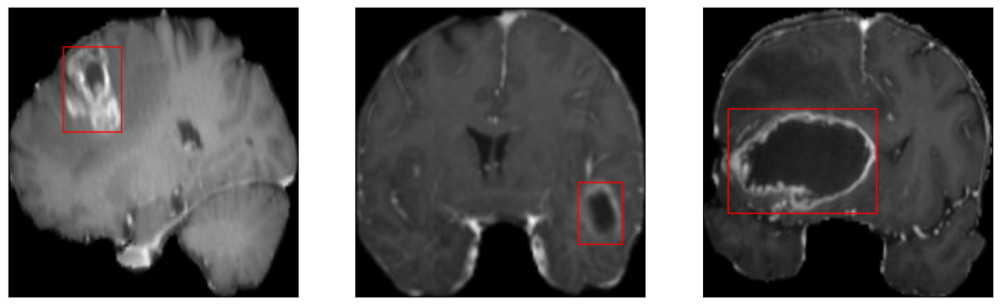

52/52 [==============================] - 113s 678ms/step - loss: 34.8258 - IoU: 0.0588 - val_loss: 1341.2552 - val_IoU: 0.0000e+00
Epoch 2/100
52/52 [==============================] - ETA: 0s - loss: 26.2265 - IoU: 0.0938
Epoch 2: val_IoU improved from 0.00000 to 0.00445, saving model to ./model_checkpoint_RESNET/model_RESNET.h5
8/8 [==============================] - 1s 134ms/step


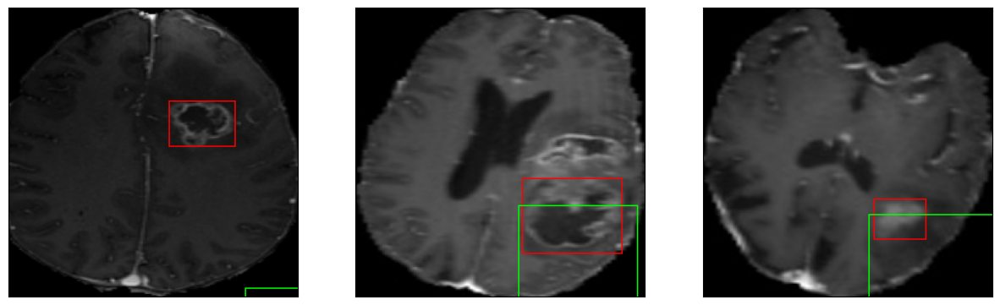

52/52 [==============================] - 22s 422ms/step - loss: 26.2265 - IoU: 0.0938 - val_loss: 81.2594 - val_IoU: 0.0044
Epoch 3/100
52/52 [==============================] - ETA: 0s - loss: 22.2098 - IoU: 0.1570
Epoch 3: val_IoU improved from 0.00445 to 0.05416, saving model to ./model_checkpoint_RESNET/model_RESNET.h5
8/8 [==============================] - 1s 137ms/step


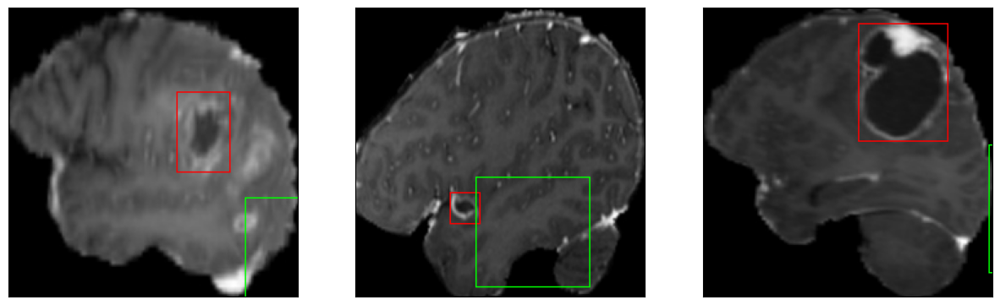

52/52 [==============================] - 24s 470ms/step - loss: 22.2098 - IoU: 0.1570 - val_loss: 51.1909 - val_IoU: 0.0542
Epoch 4/100
52/52 [==============================] - ETA: 0s - loss: 17.8134 - IoU: 0.2418
Epoch 4: val_IoU improved from 0.05416 to 0.07086, saving model to ./model_checkpoint_RESNET/model_RESNET.h5
8/8 [==============================] - 1s 139ms/step


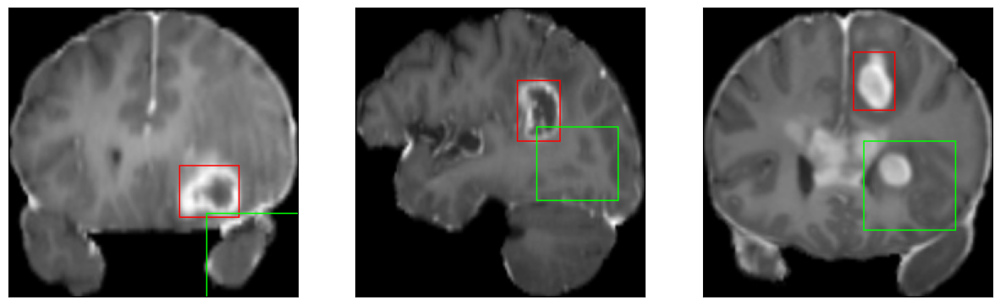

52/52 [==============================] - 27s 532ms/step - loss: 17.8134 - IoU: 0.2418 - val_loss: 33.0620 - val_IoU: 0.0709
Epoch 5/100
52/52 [==============================] - ETA: 0s - loss: 17.4326 - IoU: 0.2530
Epoch 5: val_IoU did not improve from 0.07086
8/8 [==============================] - 1s 138ms/step


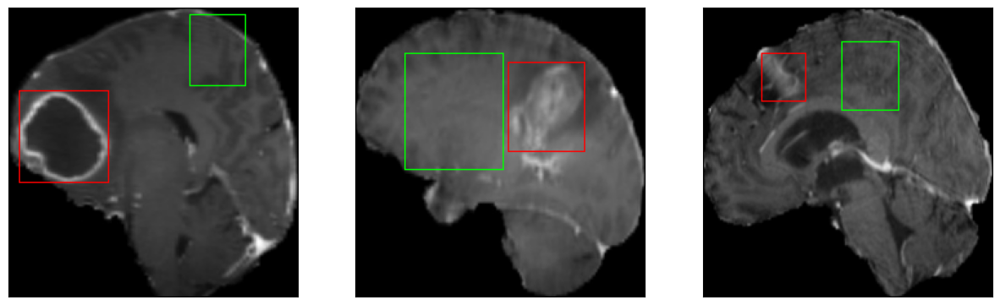

52/52 [==============================] - 19s 364ms/step - loss: 17.4326 - IoU: 0.2530 - val_loss: 44.6377 - val_IoU: 0.0498
Epoch 6/100
52/52 [==============================] - ETA: 0s - loss: 15.5068 - IoU: 0.2861
Epoch 6: val_IoU improved from 0.07086 to 0.13138, saving model to ./model_checkpoint_RESNET/model_RESNET.h5
8/8 [==============================] - 1s 139ms/step


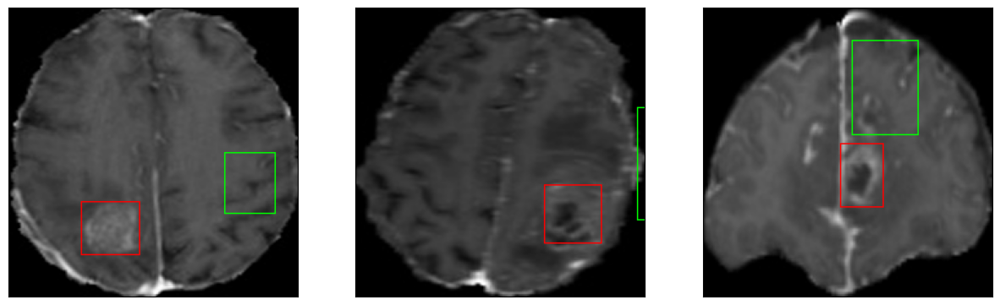

52/52 [==============================] - 23s 445ms/step - loss: 15.5068 - IoU: 0.2861 - val_loss: 24.2747 - val_IoU: 0.1314
Epoch 7/100
52/52 [==============================] - ETA: 0s - loss: 15.3636 - IoU: 0.2969
Epoch 7: val_IoU improved from 0.13138 to 0.31597, saving model to ./model_checkpoint_RESNET/model_RESNET.h5
8/8 [==============================] - 1s 140ms/step


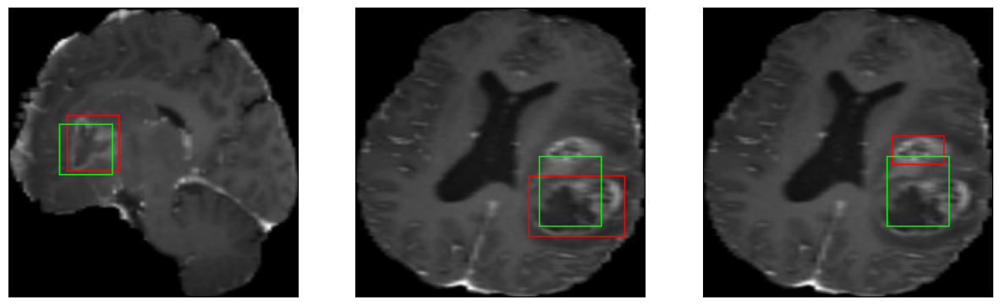

52/52 [==============================] - 30s 575ms/step - loss: 15.3636 - IoU: 0.2969 - val_loss: 15.7148 - val_IoU: 0.3160
Epoch 8/100
52/52 [==============================] - ETA: 0s - loss: 14.7022 - IoU: 0.3038
Epoch 8: val_IoU did not improve from 0.31597
8/8 [==============================] - 1s 138ms/step


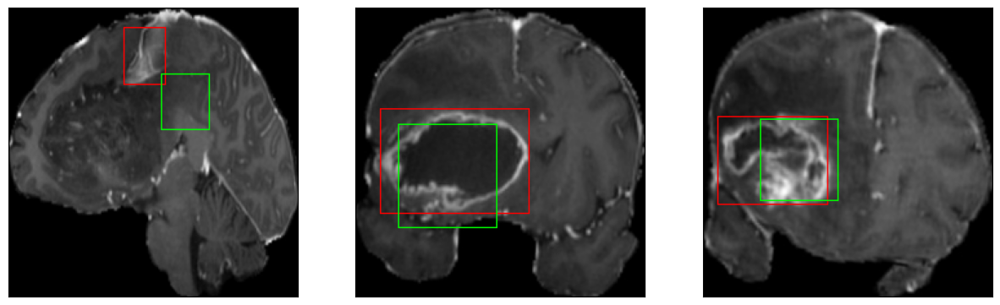

52/52 [==============================] - 19s 367ms/step - loss: 14.7022 - IoU: 0.3038 - val_loss: 20.9361 - val_IoU: 0.1741
Epoch 9/100
52/52 [==============================] - ETA: 0s - loss: 13.7731 - IoU: 0.3257
Epoch 9: val_IoU did not improve from 0.31597
8/8 [==============================] - 1s 139ms/step


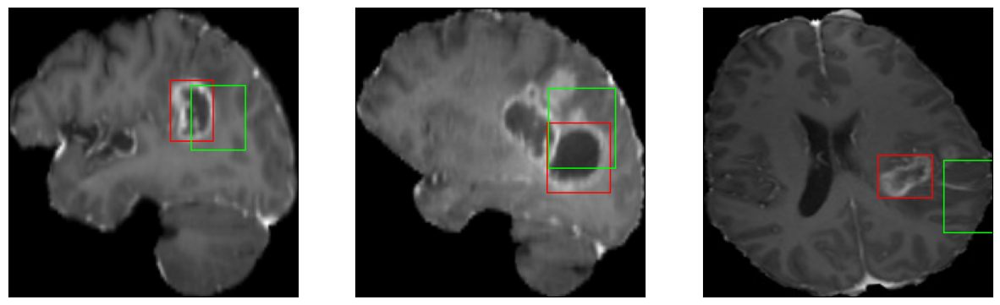

52/52 [==============================] - 19s 359ms/step - loss: 13.7731 - IoU: 0.3257 - val_loss: 17.5843 - val_IoU: 0.2325
Epoch 10/100
52/52 [==============================] - ETA: 0s - loss: 13.2516 - IoU: 0.3382
Epoch 10: val_IoU did not improve from 0.31597
8/8 [==============================] - 1s 140ms/step


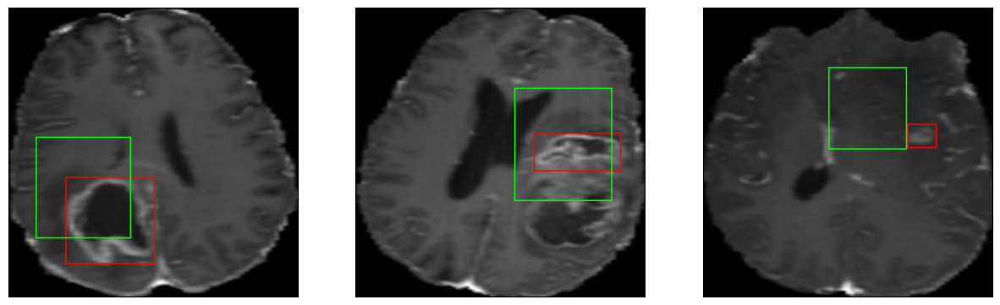

52/52 [==============================] - 19s 369ms/step - loss: 13.2516 - IoU: 0.3382 - val_loss: 17.5140 - val_IoU: 0.2981
Epoch 11/100
52/52 [==============================] - ETA: 0s - loss: 13.0828 - IoU: 0.3364
Epoch 11: val_IoU did not improve from 0.31597
8/8 [==============================] - 1s 140ms/step


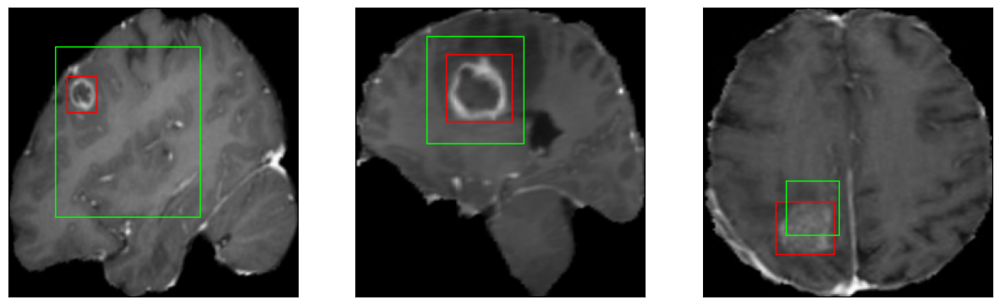

52/52 [==============================] - 19s 360ms/step - loss: 13.0828 - IoU: 0.3364 - val_loss: 29.1672 - val_IoU: 0.2702
Epoch 12/100
52/52 [==============================] - ETA: 0s - loss: 12.4989 - IoU: 0.3539
Epoch 12: val_IoU improved from 0.31597 to 0.39451, saving model to ./model_checkpoint_RESNET/model_RESNET.h5
8/8 [==============================] - 1s 139ms/step


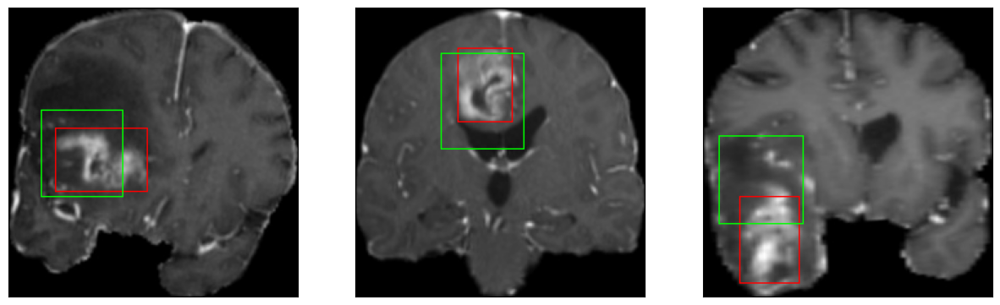

52/52 [==============================] - 27s 521ms/step - loss: 12.4989 - IoU: 0.3539 - val_loss: 15.4302 - val_IoU: 0.3945
Epoch 13/100
52/52 [==============================] - ETA: 0s - loss: 12.9008 - IoU: 0.3495
Epoch 13: val_IoU improved from 0.39451 to 0.43151, saving model to ./model_checkpoint_RESNET/model_RESNET.h5
8/8 [==============================] - 1s 140ms/step


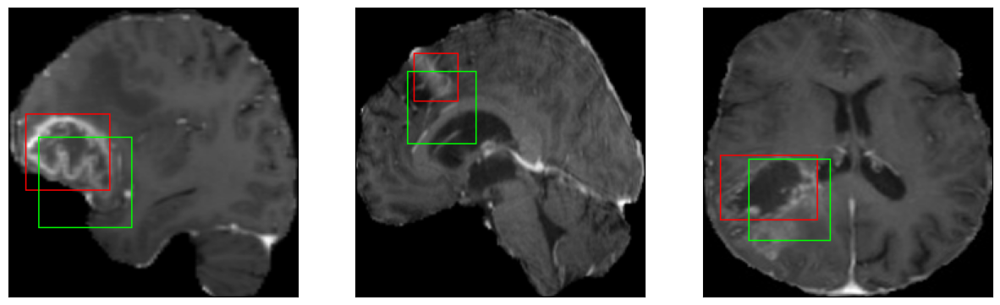

52/52 [==============================] - 22s 430ms/step - loss: 12.9008 - IoU: 0.3495 - val_loss: 12.8530 - val_IoU: 0.4315
Epoch 14/100
52/52 [==============================] - ETA: 0s - loss: 12.3353 - IoU: 0.3650
Epoch 14: val_IoU did not improve from 0.43151
8/8 [==============================] - 1s 141ms/step


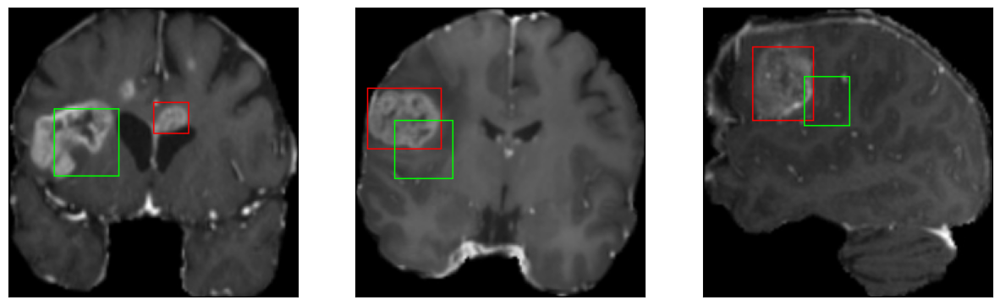

52/52 [==============================] - 19s 368ms/step - loss: 12.3353 - IoU: 0.3650 - val_loss: 19.2904 - val_IoU: 0.1985
Epoch 15/100
52/52 [==============================] - ETA: 0s - loss: 12.2774 - IoU: 0.3631
Epoch 15: val_IoU improved from 0.43151 to 0.44096, saving model to ./model_checkpoint_RESNET/model_RESNET.h5
8/8 [==============================] - 1s 141ms/step


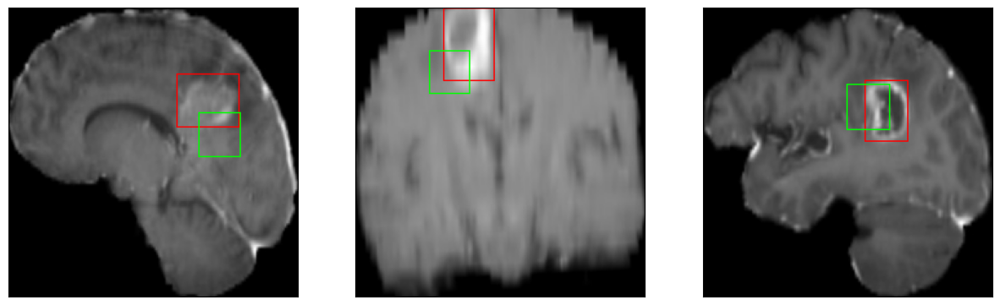

52/52 [==============================] - 25s 478ms/step - loss: 12.2774 - IoU: 0.3631 - val_loss: 11.3091 - val_IoU: 0.4410
Epoch 16/100
52/52 [==============================] - ETA: 0s - loss: 12.1963 - IoU: 0.3646
Epoch 16: val_IoU did not improve from 0.44096
8/8 [==============================] - 1s 139ms/step


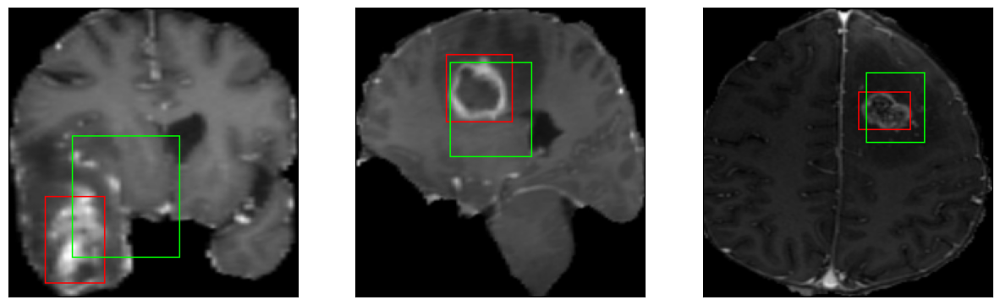

52/52 [==============================] - 19s 366ms/step - loss: 12.1963 - IoU: 0.3646 - val_loss: 20.1200 - val_IoU: 0.3024
Epoch 17/100
52/52 [==============================] - ETA: 0s - loss: 11.4014 - IoU: 0.3884
Epoch 17: val_IoU improved from 0.44096 to 0.46173, saving model to ./model_checkpoint_RESNET/model_RESNET.h5
8/8 [==============================] - 1s 140ms/step


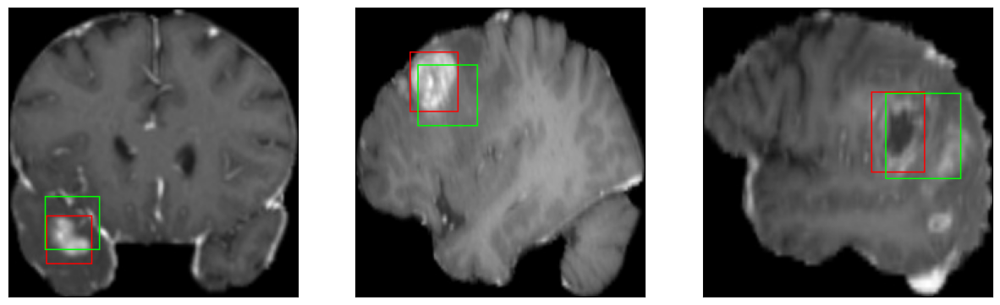

52/52 [==============================] - 22s 419ms/step - loss: 11.4014 - IoU: 0.3884 - val_loss: 10.7780 - val_IoU: 0.4617
Epoch 18/100
52/52 [==============================] - ETA: 0s - loss: 11.2702 - IoU: 0.3886
Epoch 18: val_IoU did not improve from 0.46173
8/8 [==============================] - 1s 140ms/step


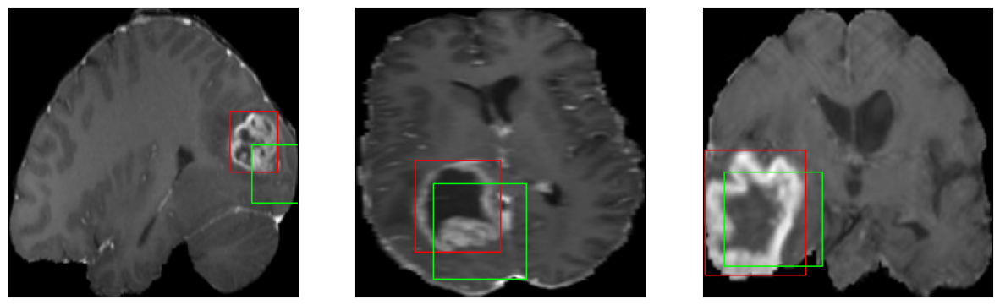

52/52 [==============================] - 19s 362ms/step - loss: 11.2702 - IoU: 0.3886 - val_loss: 15.4321 - val_IoU: 0.2998
Epoch 19/100
52/52 [==============================] - ETA: 0s - loss: 11.0288 - IoU: 0.3902
Epoch 19: val_IoU did not improve from 0.46173
8/8 [==============================] - 1s 140ms/step


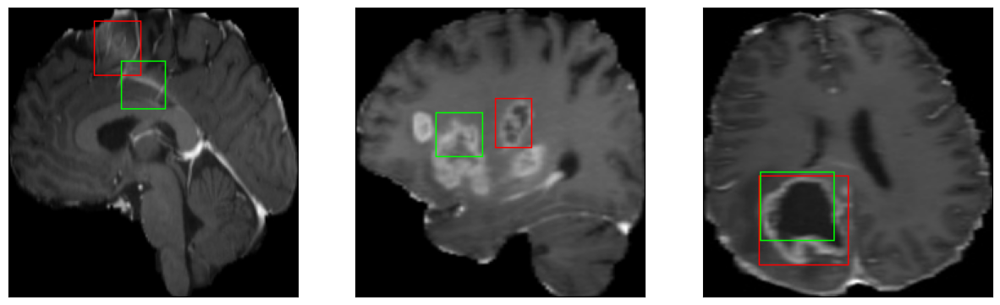

52/52 [==============================] - 19s 369ms/step - loss: 11.0288 - IoU: 0.3902 - val_loss: 12.4334 - val_IoU: 0.4074
Epoch 20/100
52/52 [==============================] - ETA: 0s - loss: 11.5899 - IoU: 0.3841
Epoch 20: val_IoU did not improve from 0.46173
8/8 [==============================] - 1s 141ms/step


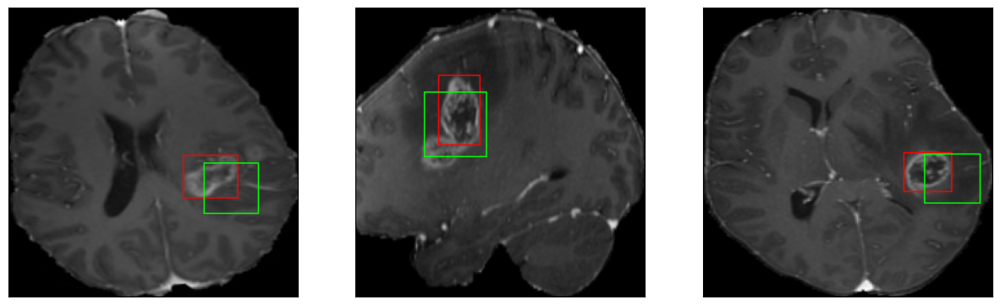

52/52 [==============================] - 19s 361ms/step - loss: 11.5899 - IoU: 0.3841 - val_loss: 10.5751 - val_IoU: 0.4409
Epoch 21/100
52/52 [==============================] - ETA: 0s - loss: 10.8532 - IoU: 0.4019
Epoch 21: val_IoU improved from 0.46173 to 0.47963, saving model to ./model_checkpoint_RESNET/model_RESNET.h5
8/8 [==============================] - 1s 140ms/step


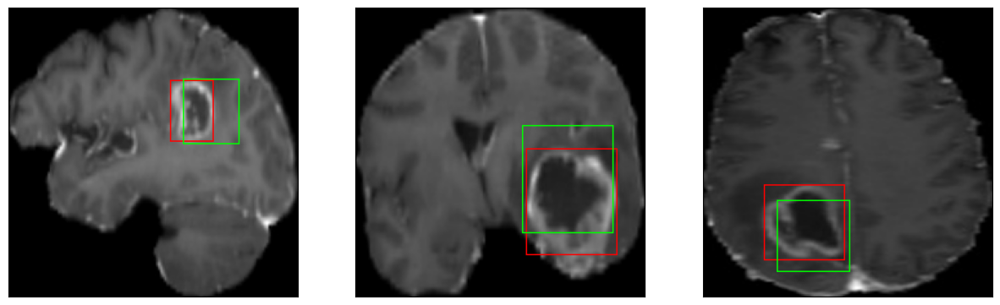

52/52 [==============================] - 25s 489ms/step - loss: 10.8532 - IoU: 0.4019 - val_loss: 10.7967 - val_IoU: 0.4796
Epoch 22/100
52/52 [==============================] - ETA: 0s - loss: 10.6977 - IoU: 0.4122
Epoch 22: val_IoU did not improve from 0.47963
8/8 [==============================] - 1s 140ms/step


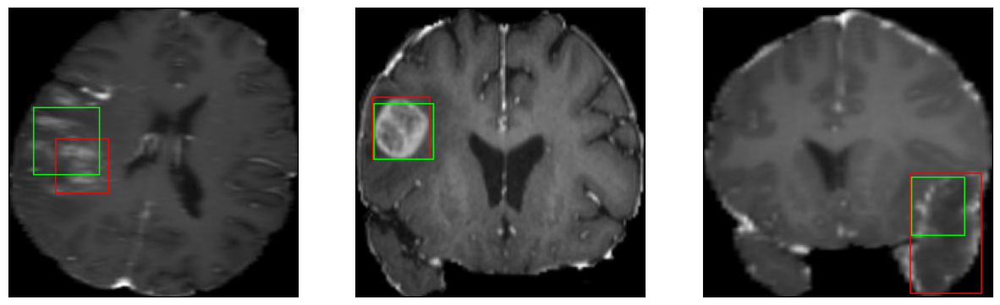

52/52 [==============================] - 19s 365ms/step - loss: 10.6977 - IoU: 0.4122 - val_loss: 9.9824 - val_IoU: 0.4638
Epoch 23/100
52/52 [==============================] - ETA: 0s - loss: 10.9332 - IoU: 0.3940
Epoch 23: val_IoU did not improve from 0.47963
8/8 [==============================] - 1s 140ms/step


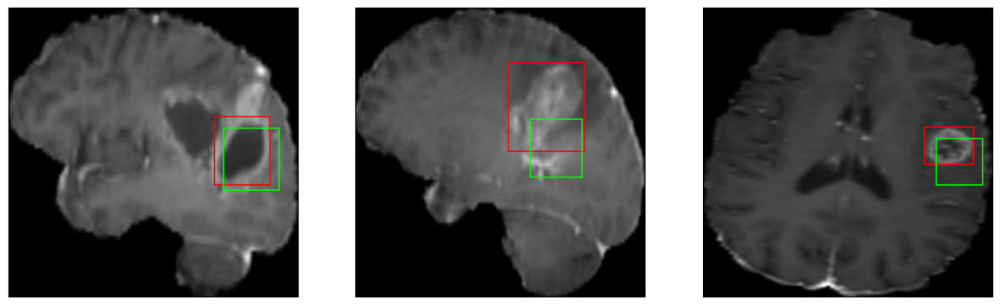

52/52 [==============================] - 19s 361ms/step - loss: 10.9332 - IoU: 0.3940 - val_loss: 12.8292 - val_IoU: 0.3726
Epoch 24/100
52/52 [==============================] - ETA: 0s - loss: 10.9453 - IoU: 0.3987
Epoch 24: val_IoU did not improve from 0.47963
8/8 [==============================] - 1s 142ms/step


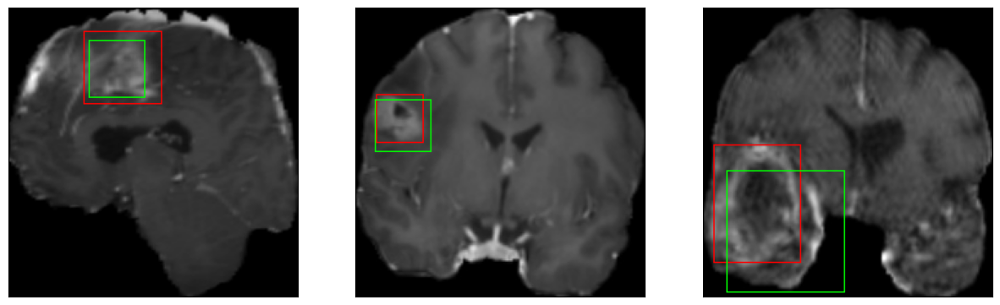

52/52 [==============================] - 19s 368ms/step - loss: 10.9453 - IoU: 0.3987 - val_loss: 11.8448 - val_IoU: 0.4462
Epoch 25/100
52/52 [==============================] - ETA: 0s - loss: 10.6738 - IoU: 0.4084
Epoch 25: val_IoU improved from 0.47963 to 0.49257, saving model to ./model_checkpoint_RESNET/model_RESNET.h5
8/8 [==============================] - 1s 142ms/step


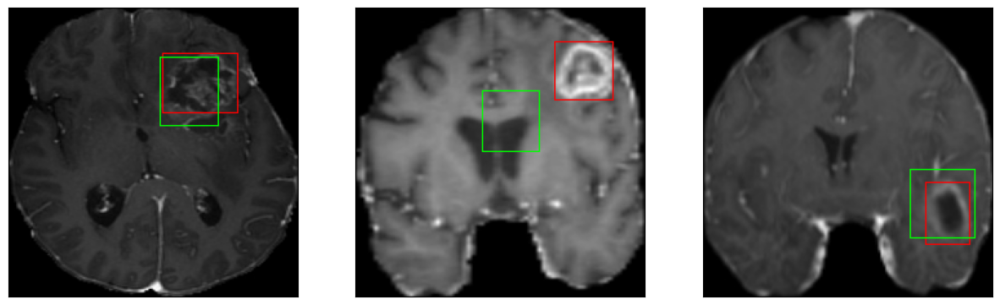

52/52 [==============================] - 22s 427ms/step - loss: 10.6738 - IoU: 0.4084 - val_loss: 10.1805 - val_IoU: 0.4926
Epoch 26/100
52/52 [==============================] - ETA: 0s - loss: 10.6074 - IoU: 0.4128
Epoch 26: val_IoU did not improve from 0.49257
8/8 [==============================] - 1s 140ms/step


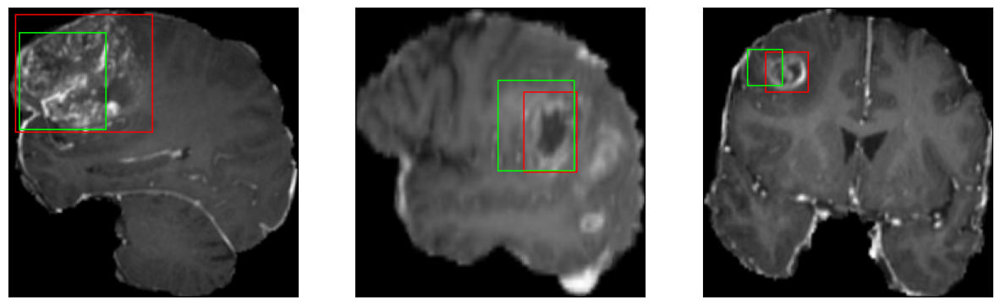

52/52 [==============================] - 19s 361ms/step - loss: 10.6074 - IoU: 0.4128 - val_loss: 10.2427 - val_IoU: 0.4667
Epoch 27/100
52/52 [==============================] - ETA: 0s - loss: 10.5001 - IoU: 0.4095
Epoch 27: val_IoU did not improve from 0.49257
8/8 [==============================] - 1s 140ms/step


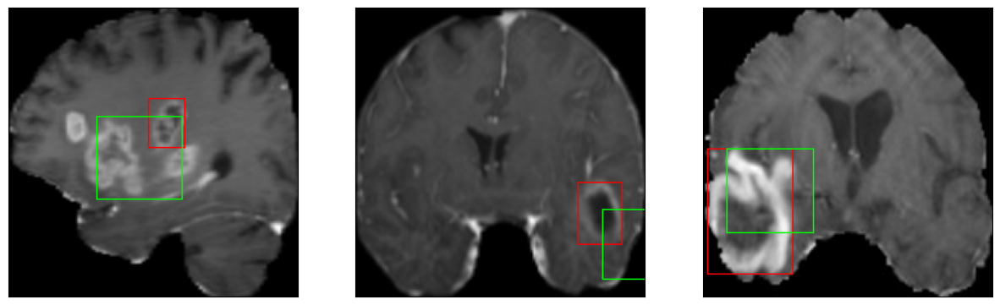

52/52 [==============================] - 19s 358ms/step - loss: 10.5001 - IoU: 0.4095 - val_loss: 12.1704 - val_IoU: 0.3851
Epoch 28/100
52/52 [==============================] - ETA: 0s - loss: 10.5577 - IoU: 0.4106
Epoch 28: val_IoU did not improve from 0.49257
8/8 [==============================] - 1s 142ms/step


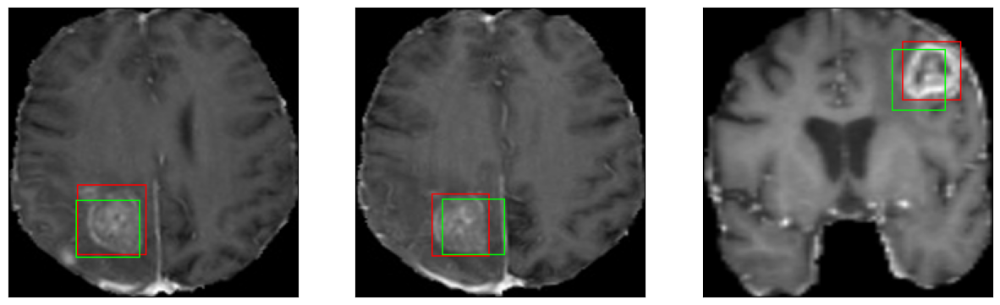

52/52 [==============================] - 19s 364ms/step - loss: 10.5577 - IoU: 0.4106 - val_loss: 11.3381 - val_IoU: 0.4840
Epoch 29/100
52/52 [==============================] - ETA: 0s - loss: 10.4807 - IoU: 0.4142
Epoch 29: val_IoU did not improve from 0.49257
8/8 [==============================] - 1s 140ms/step


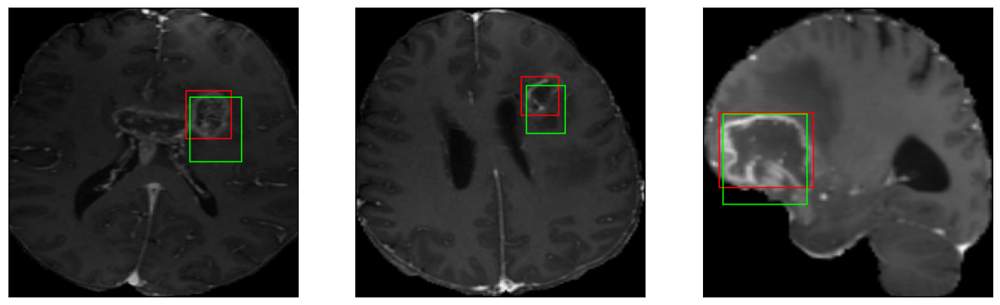

52/52 [==============================] - 19s 370ms/step - loss: 10.4807 - IoU: 0.4142 - val_loss: 14.1331 - val_IoU: 0.4127
Epoch 30/100
52/52 [==============================] - ETA: 0s - loss: 10.6431 - IoU: 0.4035
Epoch 30: val_IoU improved from 0.49257 to 0.51011, saving model to ./model_checkpoint_RESNET/model_RESNET.h5
8/8 [==============================] - 1s 140ms/step


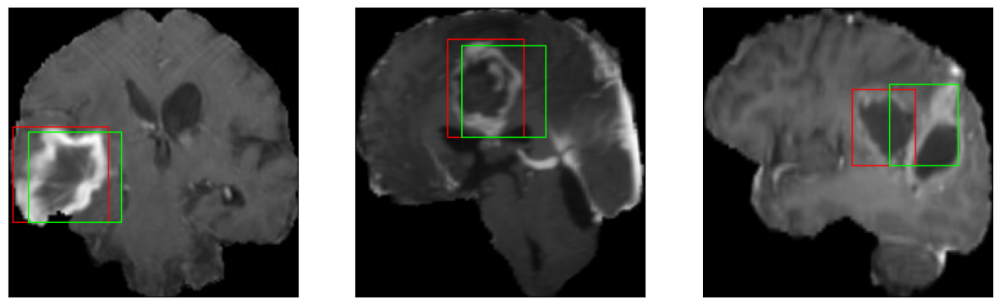

52/52 [==============================] - 30s 574ms/step - loss: 10.6431 - IoU: 0.4035 - val_loss: 9.2058 - val_IoU: 0.5101
Epoch 31/100
52/52 [==============================] - ETA: 0s - loss: 10.5341 - IoU: 0.4141
Epoch 31: val_IoU did not improve from 0.51011
8/8 [==============================] - 1s 143ms/step


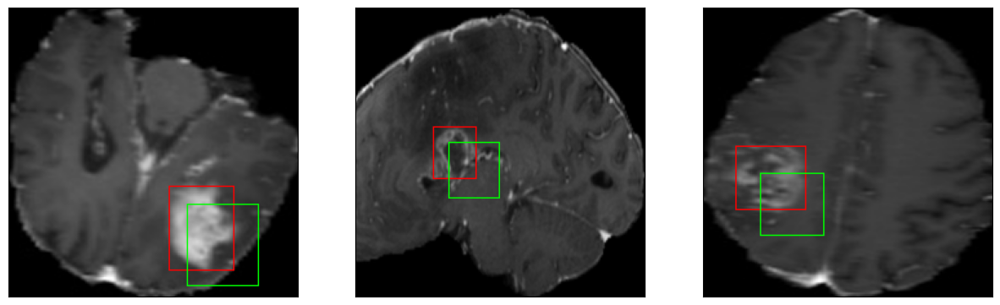

52/52 [==============================] - 19s 372ms/step - loss: 10.5341 - IoU: 0.4141 - val_loss: 14.6883 - val_IoU: 0.2715
Epoch 32/100
52/52 [==============================] - ETA: 0s - loss: 10.3783 - IoU: 0.4115
Epoch 32: val_IoU improved from 0.51011 to 0.52064, saving model to ./model_checkpoint_RESNET/model_RESNET.h5
8/8 [==============================] - 1s 142ms/step


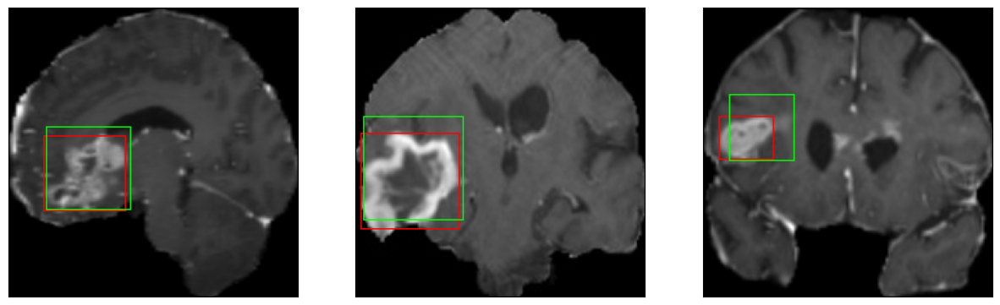

52/52 [==============================] - 25s 477ms/step - loss: 10.3783 - IoU: 0.4115 - val_loss: 11.2048 - val_IoU: 0.5206
Epoch 33/100
52/52 [==============================] - ETA: 0s - loss: 10.4669 - IoU: 0.4086
Epoch 33: val_IoU did not improve from 0.52064
8/8 [==============================] - 1s 141ms/step


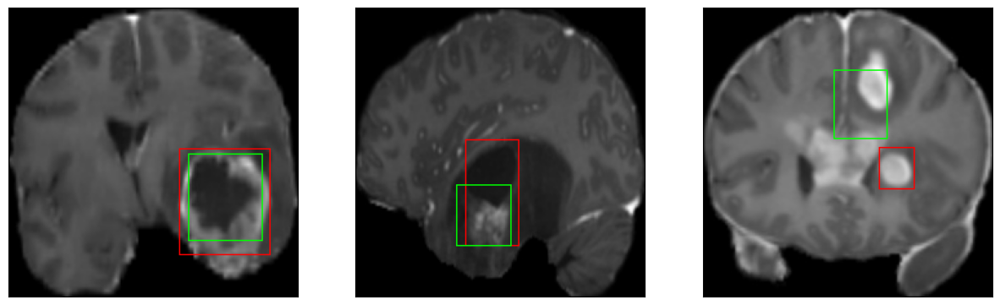

52/52 [==============================] - 19s 375ms/step - loss: 10.4669 - IoU: 0.4086 - val_loss: 10.6100 - val_IoU: 0.4516
Epoch 34/100
52/52 [==============================] - ETA: 0s - loss: 10.2133 - IoU: 0.4163
Epoch 34: val_IoU did not improve from 0.52064
8/8 [==============================] - 1s 141ms/step


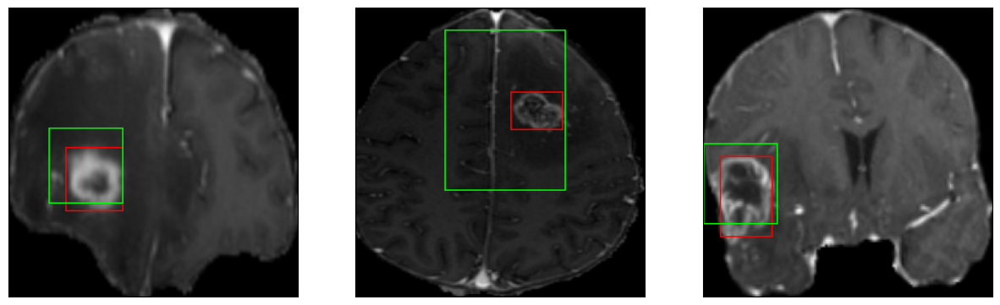

52/52 [==============================] - 19s 368ms/step - loss: 10.2133 - IoU: 0.4163 - val_loss: 17.5432 - val_IoU: 0.3898
Epoch 35/100
52/52 [==============================] - ETA: 0s - loss: 10.6621 - IoU: 0.4062
Epoch 35: val_IoU improved from 0.52064 to 0.55468, saving model to ./model_checkpoint_RESNET/model_RESNET.h5
8/8 [==============================] - 1s 141ms/step


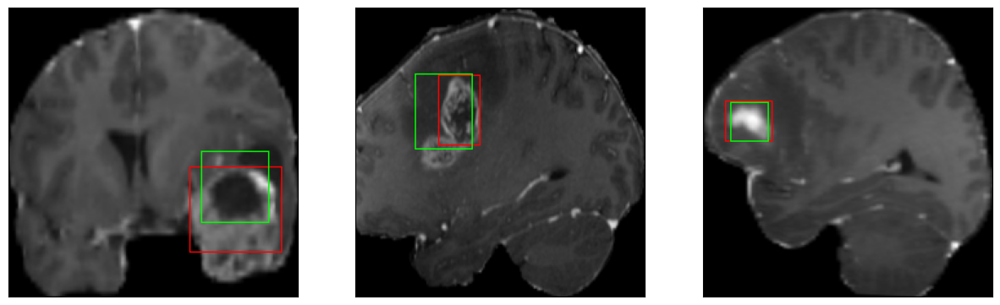

52/52 [==============================] - 25s 477ms/step - loss: 10.6621 - IoU: 0.4062 - val_loss: 8.8078 - val_IoU: 0.5547
Epoch 36/100
52/52 [==============================] - ETA: 0s - loss: 9.8672 - IoU: 0.4253
Epoch 36: val_IoU did not improve from 0.55468
8/8 [==============================] - 1s 137ms/step


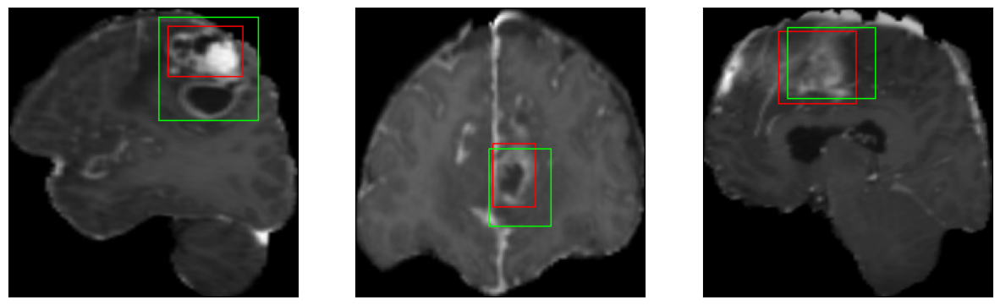

52/52 [==============================] - 20s 376ms/step - loss: 9.8672 - IoU: 0.4253 - val_loss: 12.2639 - val_IoU: 0.3973
Epoch 37/100
52/52 [==============================] - ETA: 0s - loss: 10.2434 - IoU: 0.4143
Epoch 37: val_IoU did not improve from 0.55468
8/8 [==============================] - 1s 140ms/step


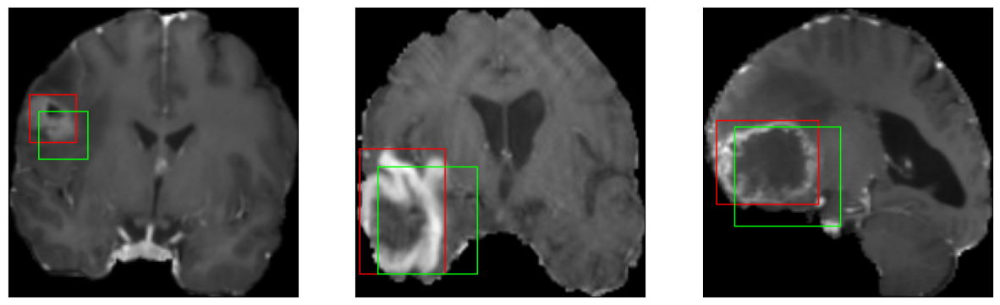

52/52 [==============================] - 19s 367ms/step - loss: 10.2434 - IoU: 0.4143 - val_loss: 11.0429 - val_IoU: 0.4325
Epoch 38/100
52/52 [==============================] - ETA: 0s - loss: 10.3466 - IoU: 0.4099
Epoch 38: val_IoU did not improve from 0.55468
8/8 [==============================] - 1s 143ms/step


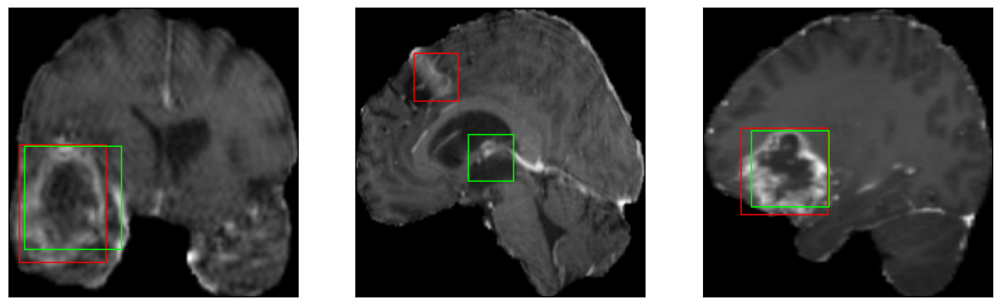

52/52 [==============================] - 19s 368ms/step - loss: 10.3466 - IoU: 0.4099 - val_loss: 9.2585 - val_IoU: 0.5398
Epoch 39/100
52/52 [==============================] - ETA: 0s - loss: 10.2340 - IoU: 0.4165
Epoch 39: val_IoU did not improve from 0.55468
8/8 [==============================] - 1s 141ms/step


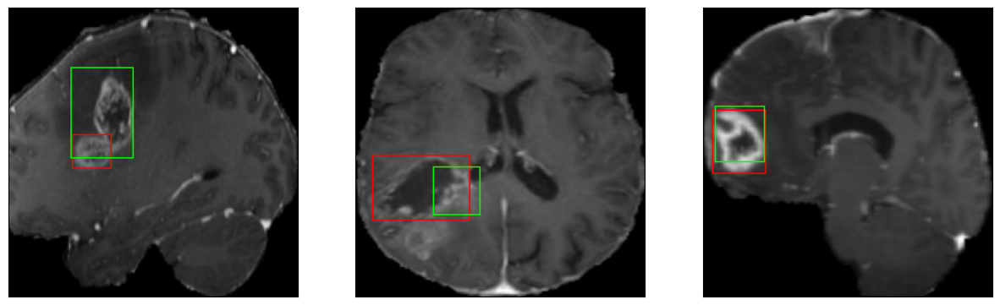

52/52 [==============================] - 19s 375ms/step - loss: 10.2340 - IoU: 0.4165 - val_loss: 9.8081 - val_IoU: 0.4913
Epoch 40/100
52/52 [==============================] - ETA: 0s - loss: 10.1744 - IoU: 0.4207
Epoch 40: val_IoU did not improve from 0.55468
8/8 [==============================] - 1s 142ms/step


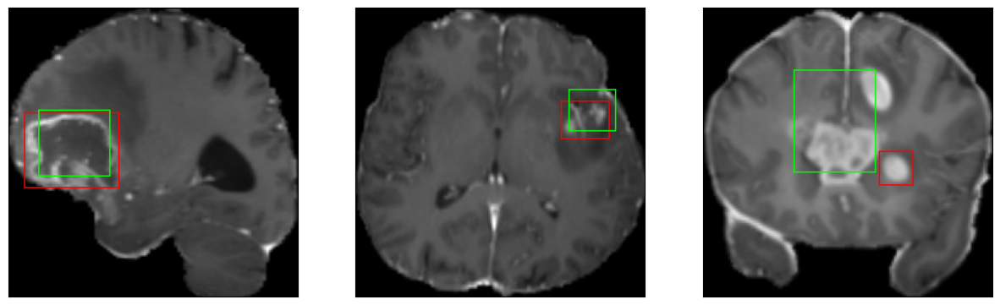

52/52 [==============================] - 19s 366ms/step - loss: 10.1744 - IoU: 0.4207 - val_loss: 10.8890 - val_IoU: 0.4697
Epoch 41/100
52/52 [==============================] - ETA: 0s - loss: 9.6886 - IoU: 0.4307
Epoch 41: val_IoU did not improve from 0.55468
8/8 [==============================] - 1s 142ms/step


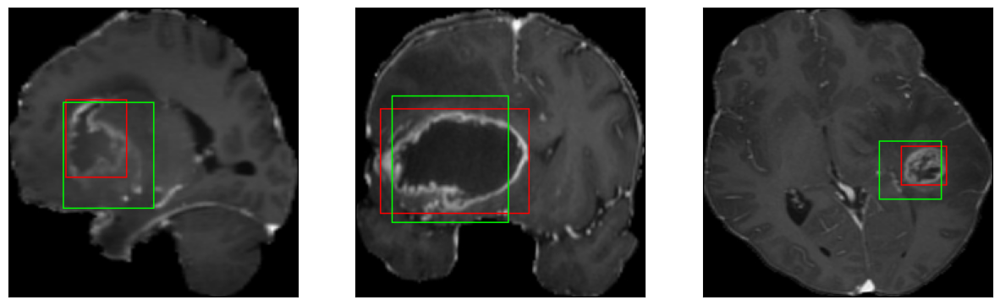

52/52 [==============================] - 19s 371ms/step - loss: 9.6886 - IoU: 0.4307 - val_loss: 20.8570 - val_IoU: 0.3495
Epoch 42/100
52/52 [==============================] - ETA: 0s - loss: 10.0286 - IoU: 0.4204
Epoch 42: val_IoU did not improve from 0.55468
8/8 [==============================] - 1s 142ms/step


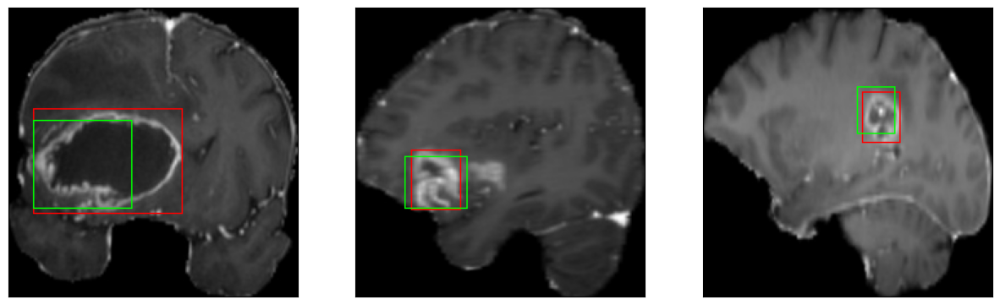

52/52 [==============================] - 19s 373ms/step - loss: 10.0286 - IoU: 0.4204 - val_loss: 13.0774 - val_IoU: 0.4546
Epoch 43/100
52/52 [==============================] - ETA: 0s - loss: 10.2766 - IoU: 0.4130
Epoch 43: val_IoU improved from 0.55468 to 0.56712, saving model to ./model_checkpoint_RESNET/model_RESNET.h5
8/8 [==============================] - 1s 142ms/step


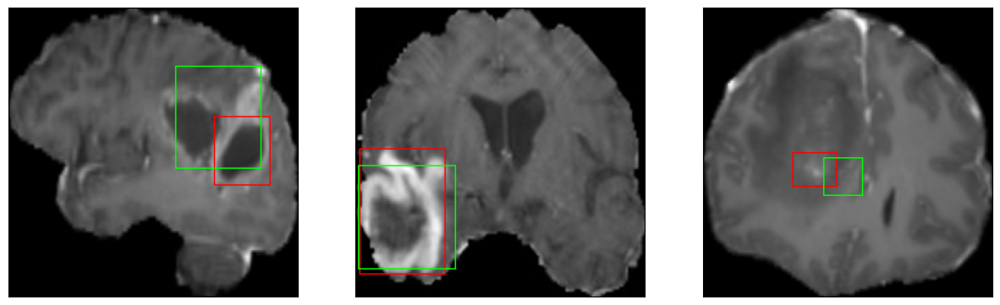

52/52 [==============================] - 25s 485ms/step - loss: 10.2766 - IoU: 0.4130 - val_loss: 8.0333 - val_IoU: 0.5671
Epoch 44/100
52/52 [==============================] - ETA: 0s - loss: 9.5347 - IoU: 0.4369
Epoch 44: val_IoU did not improve from 0.56712
8/8 [==============================] - 1s 140ms/step


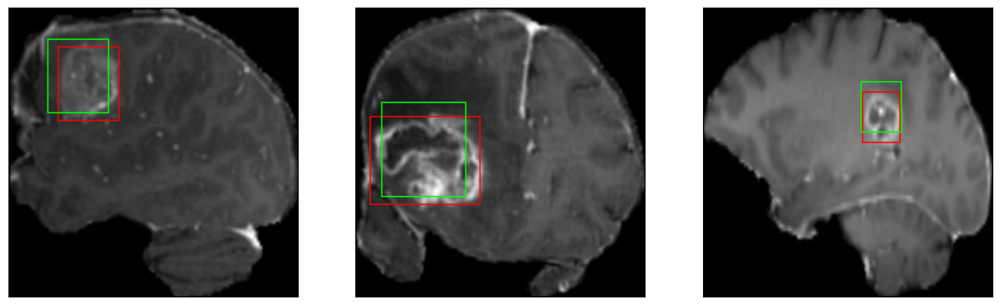

52/52 [==============================] - 19s 367ms/step - loss: 9.5347 - IoU: 0.4369 - val_loss: 10.4855 - val_IoU: 0.4351
Epoch 45/100
52/52 [==============================] - ETA: 0s - loss: 9.5390 - IoU: 0.4300
Epoch 45: val_IoU did not improve from 0.56712
8/8 [==============================] - 1s 142ms/step


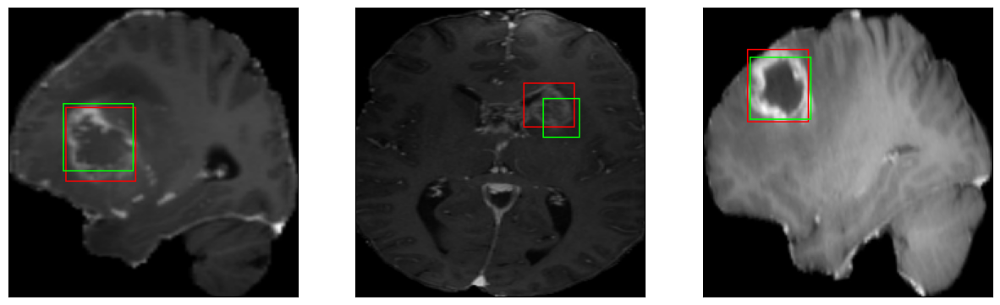

52/52 [==============================] - 19s 376ms/step - loss: 9.5390 - IoU: 0.4300 - val_loss: 9.0123 - val_IoU: 0.5237
Epoch 46/100
52/52 [==============================] - ETA: 0s - loss: 9.8840 - IoU: 0.4217
Epoch 46: val_IoU did not improve from 0.56712
8/8 [==============================] - 1s 141ms/step


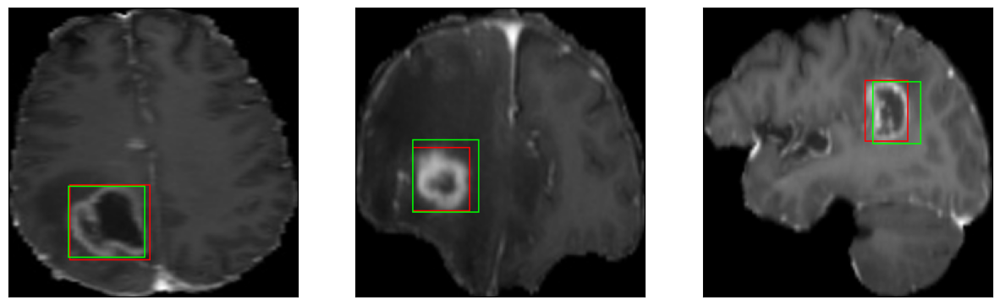

52/52 [==============================] - 19s 368ms/step - loss: 9.8840 - IoU: 0.4217 - val_loss: 10.1939 - val_IoU: 0.4981
Epoch 47/100
52/52 [==============================] - ETA: 0s - loss: 9.8081 - IoU: 0.4192
Epoch 47: val_IoU did not improve from 0.56712
8/8 [==============================] - 1s 143ms/step


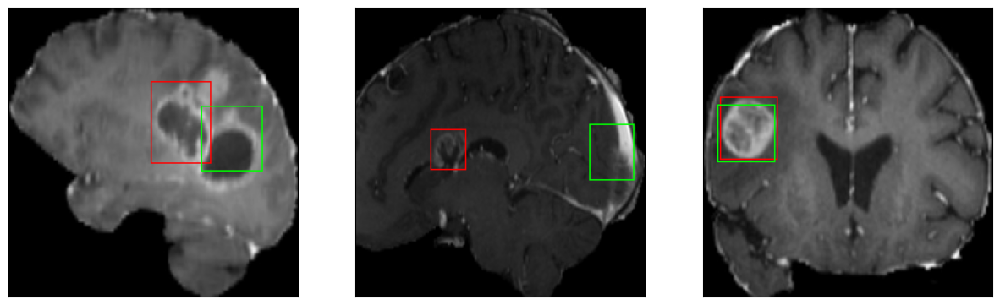

52/52 [==============================] - 19s 372ms/step - loss: 9.8081 - IoU: 0.4192 - val_loss: 10.5161 - val_IoU: 0.4927
Epoch 48/100
52/52 [==============================] - ETA: 0s - loss: 9.8248 - IoU: 0.4191
Epoch 48: val_IoU did not improve from 0.56712
8/8 [==============================] - 1s 141ms/step


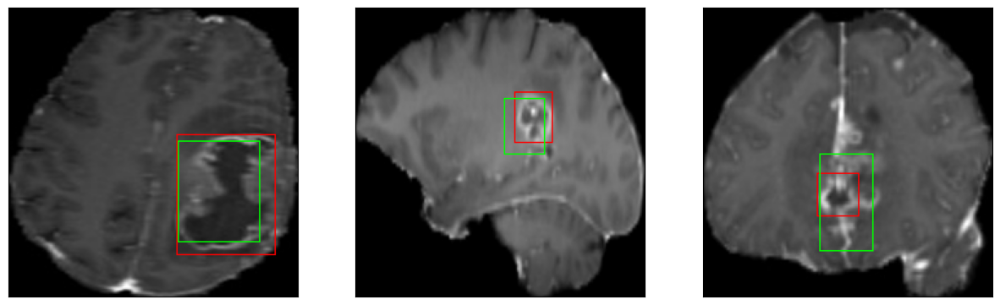

52/52 [==============================] - 20s 379ms/step - loss: 9.8248 - IoU: 0.4191 - val_loss: 10.0707 - val_IoU: 0.4537
Epoch 49/100
52/52 [==============================] - ETA: 0s - loss: 9.4379 - IoU: 0.4376
Epoch 49: val_IoU did not improve from 0.56712
8/8 [==============================] - 1s 141ms/step


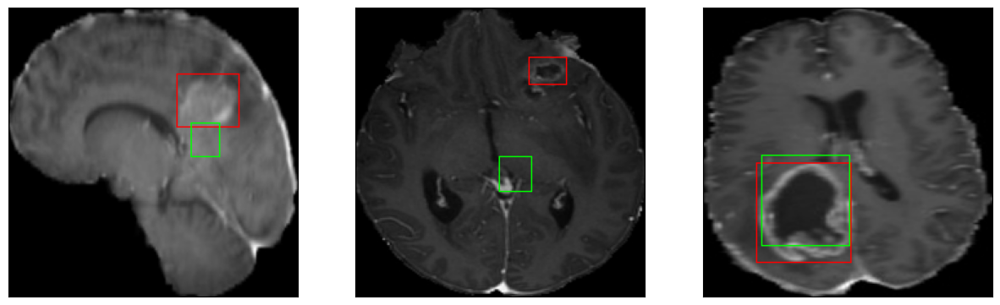

52/52 [==============================] - 19s 366ms/step - loss: 9.4379 - IoU: 0.4376 - val_loss: 9.2391 - val_IoU: 0.5379
Epoch 50/100
52/52 [==============================] - ETA: 0s - loss: 9.1925 - IoU: 0.4427
Epoch 50: val_IoU did not improve from 0.56712
8/8 [==============================] - 1s 144ms/step


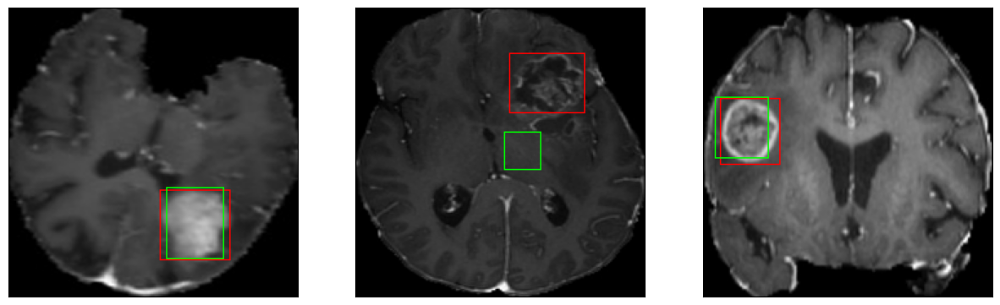

52/52 [==============================] - 19s 369ms/step - loss: 9.1925 - IoU: 0.4427 - val_loss: 13.2011 - val_IoU: 0.3629
Epoch 51/100
52/52 [==============================] - ETA: 0s - loss: 9.6051 - IoU: 0.4278
Epoch 51: val_IoU did not improve from 0.56712
8/8 [==============================] - 1s 143ms/step


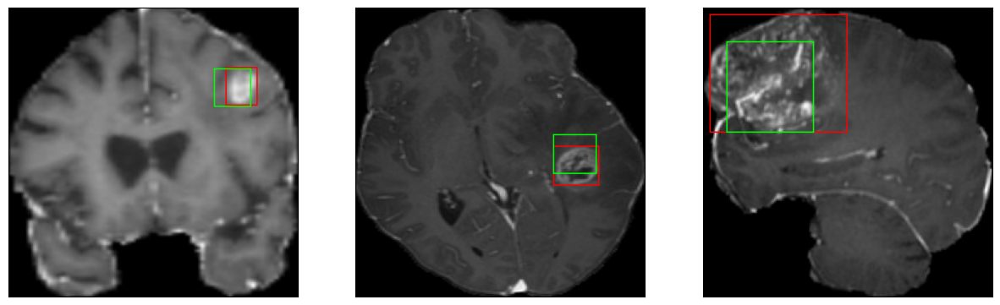

52/52 [==============================] - 20s 379ms/step - loss: 9.6051 - IoU: 0.4278 - val_loss: 8.7552 - val_IoU: 0.5282
Epoch 52/100
52/52 [==============================] - ETA: 0s - loss: 9.0946 - IoU: 0.4396
Epoch 52: val_IoU did not improve from 0.56712
8/8 [==============================] - 1s 146ms/step


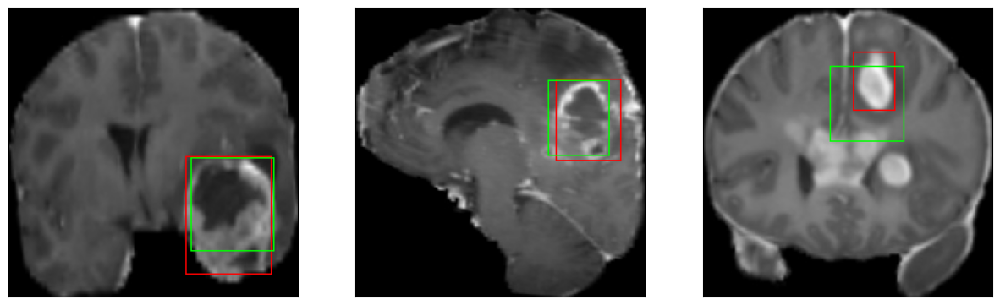

52/52 [==============================] - 20s 386ms/step - loss: 9.0946 - IoU: 0.4396 - val_loss: 8.9829 - val_IoU: 0.5227
Epoch 53/100
52/52 [==============================] - ETA: 0s - loss: 9.2965 - IoU: 0.4310
Epoch 53: val_IoU did not improve from 0.56712
8/8 [==============================] - 1s 143ms/step


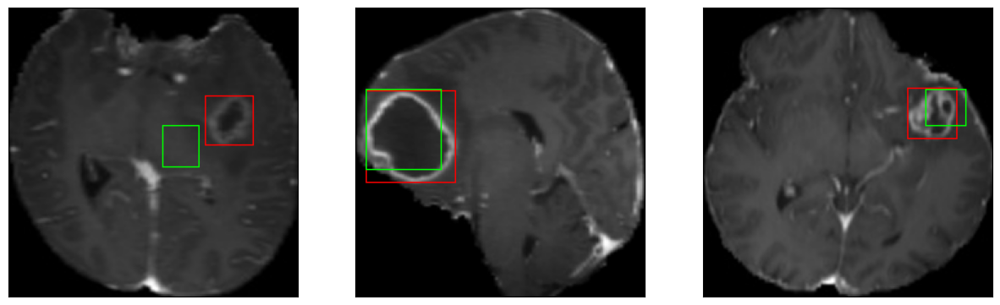

52/52 [==============================] - 20s 376ms/step - loss: 9.2965 - IoU: 0.4310 - val_loss: 9.3584 - val_IoU: 0.4780
Epoch 54/100
52/52 [==============================] - ETA: 0s - loss: 9.4936 - IoU: 0.4343
Epoch 54: val_IoU did not improve from 0.56712
8/8 [==============================] - 1s 143ms/step


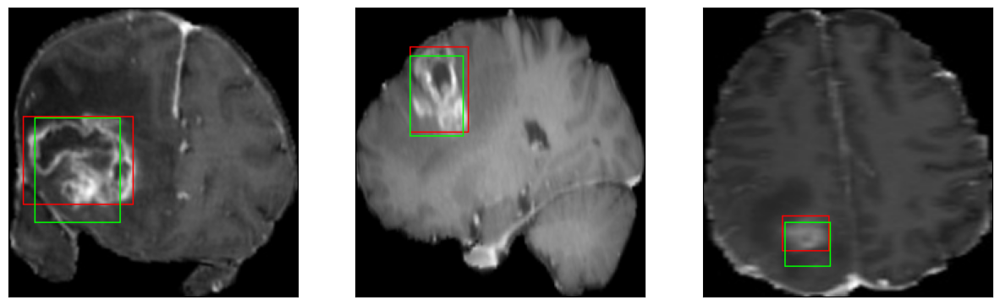

52/52 [==============================] - 19s 376ms/step - loss: 9.4936 - IoU: 0.4343 - val_loss: 8.8899 - val_IoU: 0.5531
Epoch 55/100
52/52 [==============================] - ETA: 0s - loss: 9.1898 - IoU: 0.4379
Epoch 55: val_IoU did not improve from 0.56712
8/8 [==============================] - 1s 146ms/step


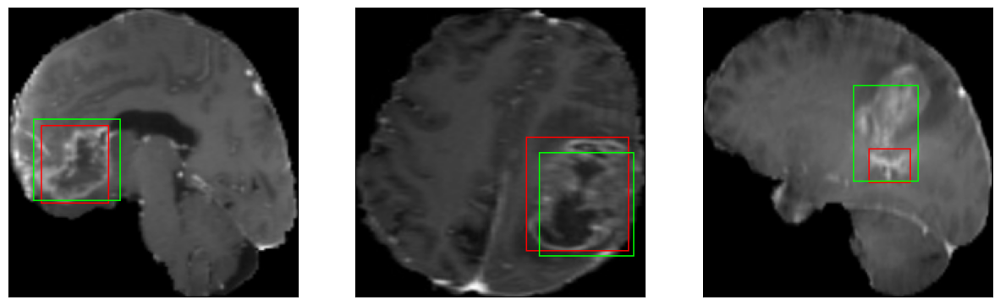

52/52 [==============================] - 20s 378ms/step - loss: 9.1898 - IoU: 0.4379 - val_loss: 9.4421 - val_IoU: 0.5119
Epoch 56/100
52/52 [==============================] - ETA: 0s - loss: 9.5745 - IoU: 0.4338
Epoch 56: val_IoU did not improve from 0.56712
8/8 [==============================] - 1s 146ms/step


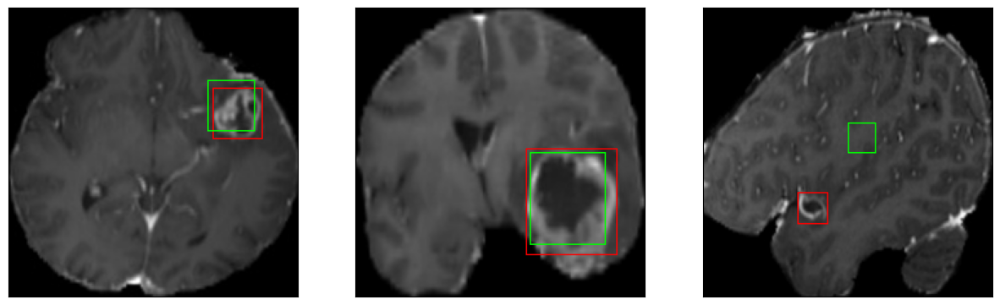

52/52 [==============================] - 20s 380ms/step - loss: 9.5745 - IoU: 0.4338 - val_loss: 8.9553 - val_IoU: 0.5296
Epoch 57/100
52/52 [==============================] - ETA: 0s - loss: 9.2324 - IoU: 0.4416
Epoch 57: val_IoU did not improve from 0.56712
8/8 [==============================] - 1s 144ms/step


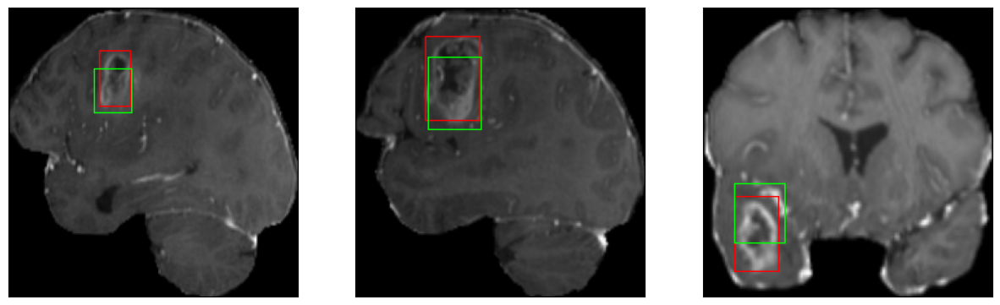

52/52 [==============================] - 19s 369ms/step - loss: 9.2324 - IoU: 0.4416 - val_loss: 9.4031 - val_IoU: 0.4849
Epoch 58/100
52/52 [==============================] - ETA: 0s - loss: 9.1910 - IoU: 0.4353
Epoch 58: val_IoU improved from 0.56712 to 0.59287, saving model to ./model_checkpoint_RESNET/model_RESNET.h5
8/8 [==============================] - 1s 141ms/step


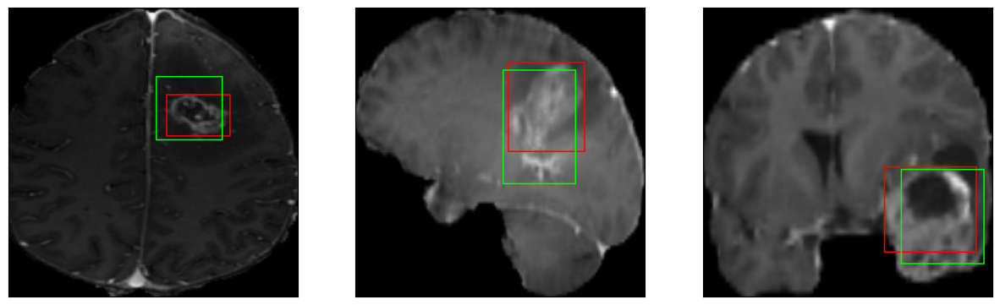

52/52 [==============================] - 29s 564ms/step - loss: 9.1910 - IoU: 0.4353 - val_loss: 8.5957 - val_IoU: 0.5929
Epoch 59/100
52/52 [==============================] - ETA: 0s - loss: 9.1443 - IoU: 0.4380
Epoch 59: val_IoU did not improve from 0.59287
8/8 [==============================] - 1s 144ms/step


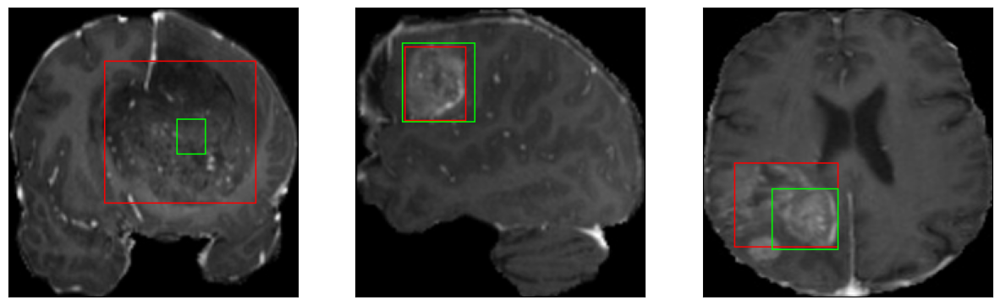

52/52 [==============================] - 20s 378ms/step - loss: 9.1443 - IoU: 0.4380 - val_loss: 8.3185 - val_IoU: 0.5566
Epoch 60/100
52/52 [==============================] - ETA: 0s - loss: 9.1678 - IoU: 0.4334
Epoch 60: val_IoU did not improve from 0.59287
8/8 [==============================] - 1s 144ms/step


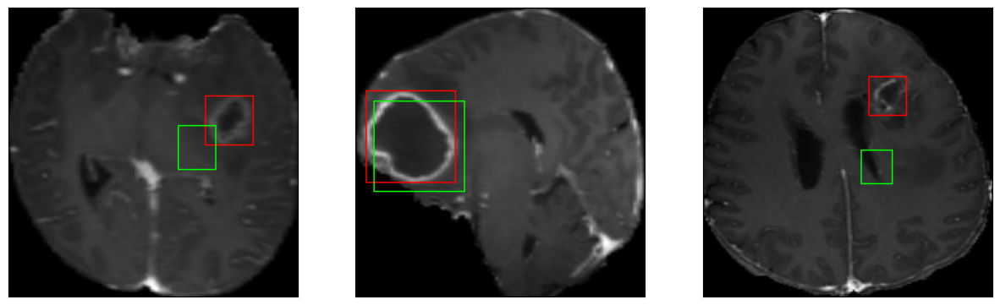

52/52 [==============================] - 19s 369ms/step - loss: 9.1678 - IoU: 0.4334 - val_loss: 8.2860 - val_IoU: 0.5447
Epoch 61/100
52/52 [==============================] - ETA: 0s - loss: 8.8541 - IoU: 0.4517
Epoch 61: val_IoU did not improve from 0.59287
8/8 [==============================] - 1s 144ms/step


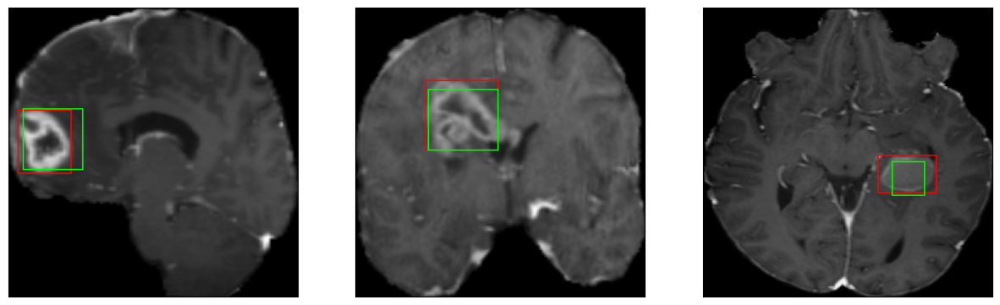

52/52 [==============================] - 19s 371ms/step - loss: 8.8541 - IoU: 0.4517 - val_loss: 8.2567 - val_IoU: 0.5417
Epoch 62/100
52/52 [==============================] - ETA: 0s - loss: 9.0118 - IoU: 0.4451
Epoch 62: val_IoU did not improve from 0.59287
8/8 [==============================] - 1s 143ms/step


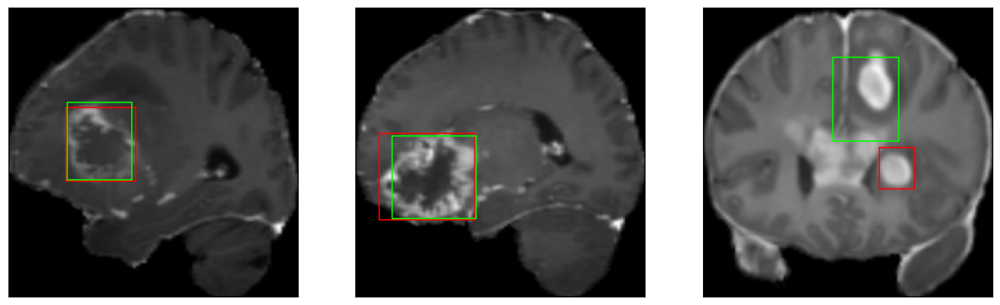

52/52 [==============================] - 19s 371ms/step - loss: 9.0118 - IoU: 0.4451 - val_loss: 8.8008 - val_IoU: 0.5546
Epoch 63/100
52/52 [==============================] - ETA: 0s - loss: 9.4362 - IoU: 0.4403
Epoch 63: val_IoU did not improve from 0.59287
8/8 [==============================] - 1s 144ms/step


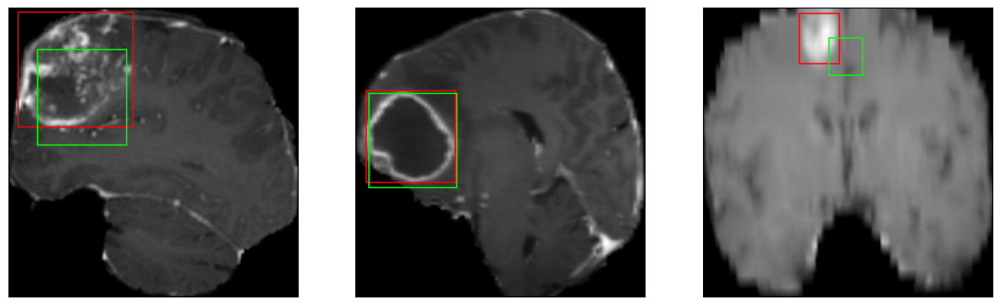

52/52 [==============================] - 20s 381ms/step - loss: 9.4362 - IoU: 0.4403 - val_loss: 10.1257 - val_IoU: 0.4988
Epoch 64/100
52/52 [==============================] - ETA: 0s - loss: 9.1877 - IoU: 0.4401
Epoch 64: val_IoU did not improve from 0.59287
8/8 [==============================] - 1s 143ms/step


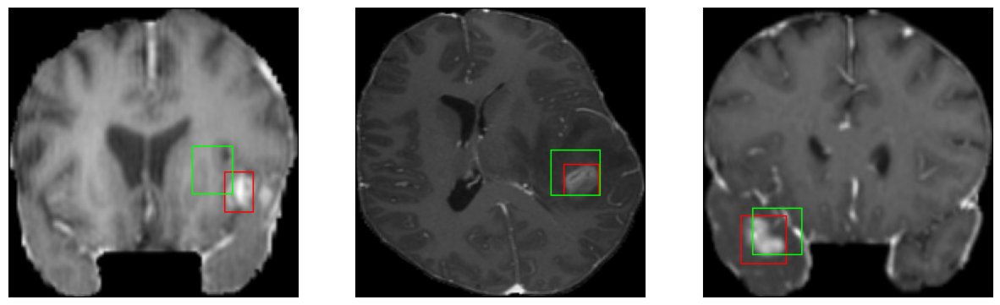

52/52 [==============================] - 19s 373ms/step - loss: 9.1877 - IoU: 0.4401 - val_loss: 8.4200 - val_IoU: 0.5507
Epoch 65/100
52/52 [==============================] - ETA: 0s - loss: 8.7739 - IoU: 0.4454
Epoch 65: val_IoU did not improve from 0.59287
8/8 [==============================] - 1s 142ms/step


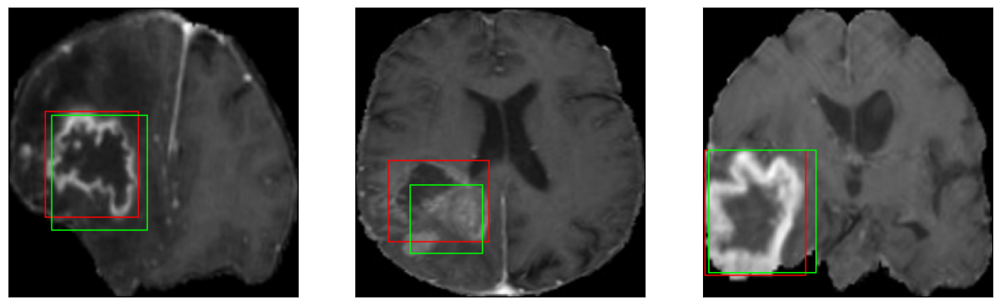

52/52 [==============================] - 19s 374ms/step - loss: 8.7739 - IoU: 0.4454 - val_loss: 9.9955 - val_IoU: 0.4932
Epoch 66/100
52/52 [==============================] - ETA: 0s - loss: 9.2775 - IoU: 0.4392
Epoch 66: val_IoU did not improve from 0.59287
8/8 [==============================] - 1s 143ms/step


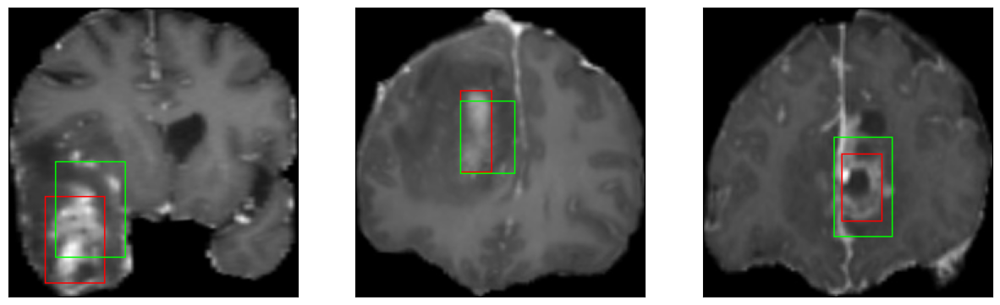

52/52 [==============================] - 20s 376ms/step - loss: 9.2775 - IoU: 0.4392 - val_loss: 9.8368 - val_IoU: 0.4823
Epoch 67/100
52/52 [==============================] - ETA: 0s - loss: 8.6221 - IoU: 0.4637
Epoch 67: val_IoU did not improve from 0.59287
8/8 [==============================] - 1s 142ms/step


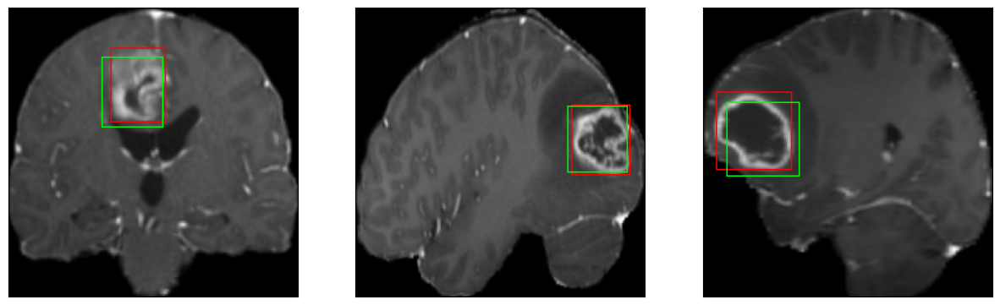

52/52 [==============================] - 19s 375ms/step - loss: 8.6221 - IoU: 0.4637 - val_loss: 8.5540 - val_IoU: 0.5670
Epoch 68/100
52/52 [==============================] - ETA: 0s - loss: 8.9063 - IoU: 0.4478
Epoch 68: val_IoU did not improve from 0.59287
8/8 [==============================] - 1s 143ms/step


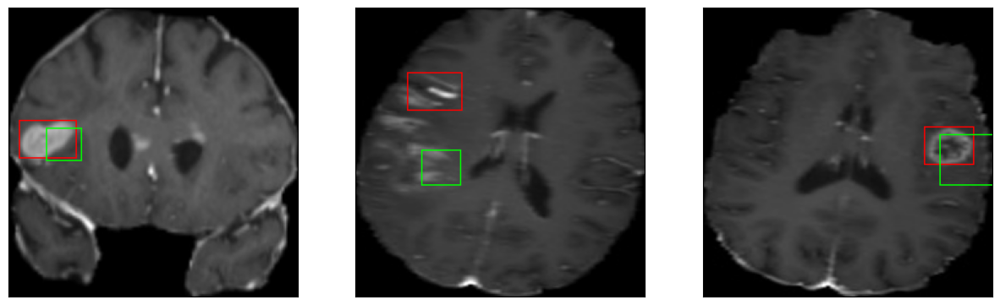

52/52 [==============================] - 20s 377ms/step - loss: 8.9063 - IoU: 0.4478 - val_loss: 12.6703 - val_IoU: 0.4484
Epoch 69/100
52/52 [==============================] - ETA: 0s - loss: 9.1889 - IoU: 0.4388
Epoch 69: val_IoU did not improve from 0.59287
8/8 [==============================] - 1s 144ms/step


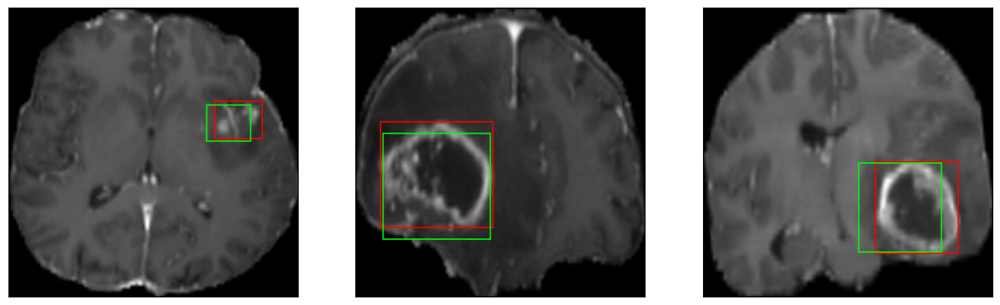

52/52 [==============================] - 20s 381ms/step - loss: 9.1889 - IoU: 0.4388 - val_loss: 9.0458 - val_IoU: 0.5150
Epoch 70/100
52/52 [==============================] - ETA: 0s - loss: 8.8668 - IoU: 0.4505
Epoch 70: val_IoU did not improve from 0.59287
8/8 [==============================] - 1s 144ms/step


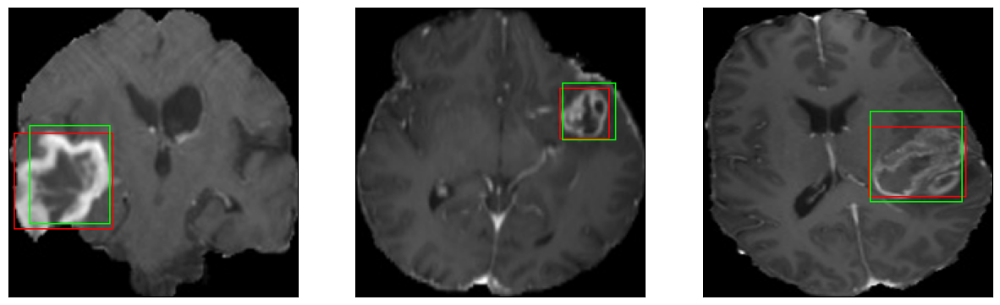

52/52 [==============================] - 19s 372ms/step - loss: 8.8668 - IoU: 0.4505 - val_loss: 8.6748 - val_IoU: 0.5377
Epoch 71/100
52/52 [==============================] - ETA: 0s - loss: 8.9959 - IoU: 0.4495
Epoch 71: val_IoU did not improve from 0.59287
8/8 [==============================] - 1s 144ms/step


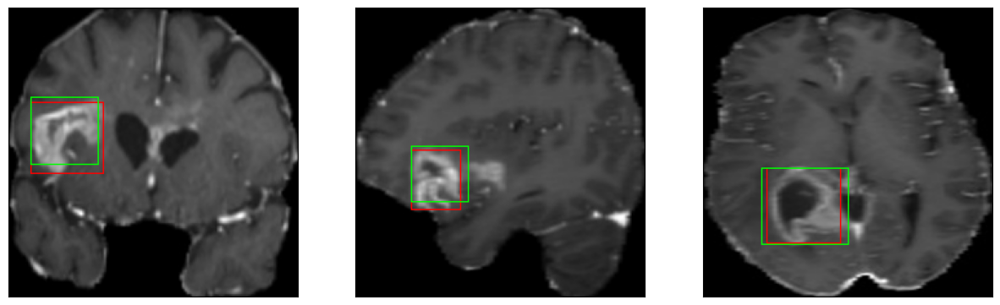

52/52 [==============================] - 20s 378ms/step - loss: 8.9959 - IoU: 0.4495 - val_loss: 9.7974 - val_IoU: 0.5162
Epoch 72/100
52/52 [==============================] - ETA: 0s - loss: 9.2739 - IoU: 0.4378
Epoch 72: val_IoU did not improve from 0.59287
8/8 [==============================] - 1s 143ms/step


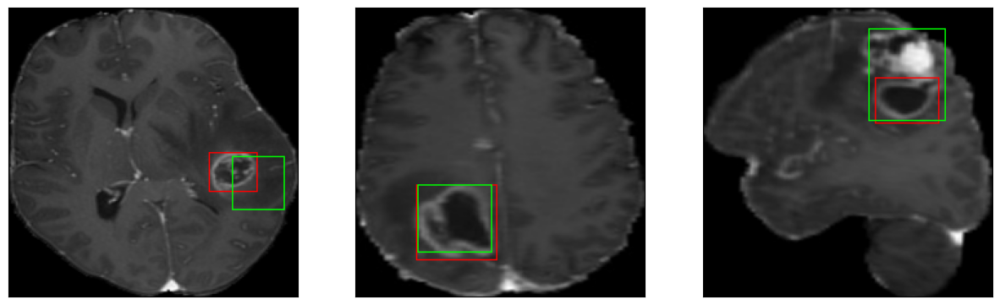

52/52 [==============================] - 20s 379ms/step - loss: 9.2739 - IoU: 0.4378 - val_loss: 10.5576 - val_IoU: 0.4528
Epoch 73/100
52/52 [==============================] - ETA: 0s - loss: 9.1444 - IoU: 0.4365
Epoch 73: val_IoU did not improve from 0.59287
8/8 [==============================] - 1s 143ms/step


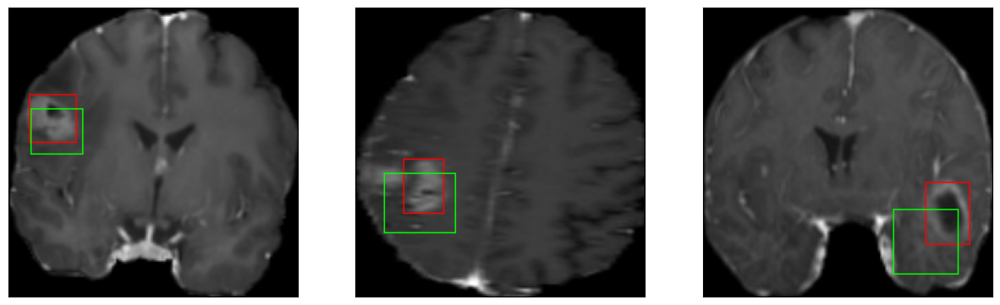

52/52 [==============================] - 19s 373ms/step - loss: 9.1444 - IoU: 0.4365 - val_loss: 9.1790 - val_IoU: 0.5220
Epoch 74/100
52/52 [==============================] - ETA: 0s - loss: 8.9361 - IoU: 0.4541
Epoch 74: val_IoU did not improve from 0.59287
8/8 [==============================] - 1s 144ms/step


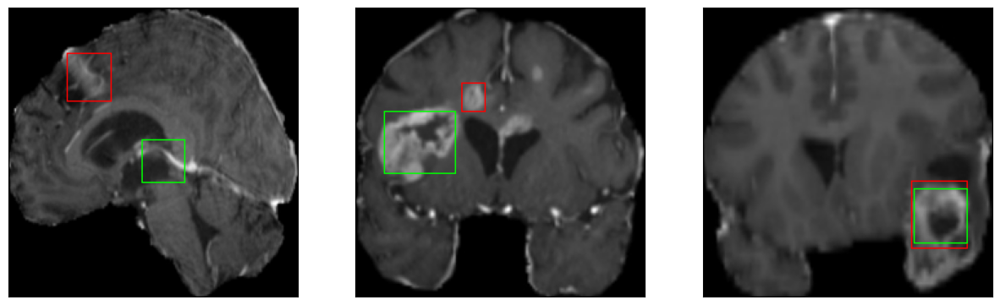

52/52 [==============================] - 20s 377ms/step - loss: 8.9361 - IoU: 0.4541 - val_loss: 9.7337 - val_IoU: 0.5182
Epoch 75/100
52/52 [==============================] - ETA: 0s - loss: 8.8348 - IoU: 0.4555
Epoch 75: val_IoU did not improve from 0.59287
8/8 [==============================] - 1s 143ms/step


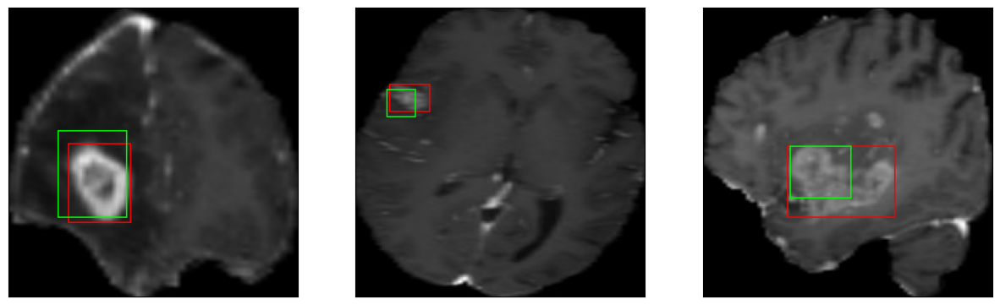

52/52 [==============================] - 19s 376ms/step - loss: 8.8348 - IoU: 0.4555 - val_loss: 7.7982 - val_IoU: 0.5819
Epoch 76/100
52/52 [==============================] - ETA: 0s - loss: 9.1307 - IoU: 0.4437
Epoch 76: val_IoU did not improve from 0.59287
8/8 [==============================] - 1s 144ms/step


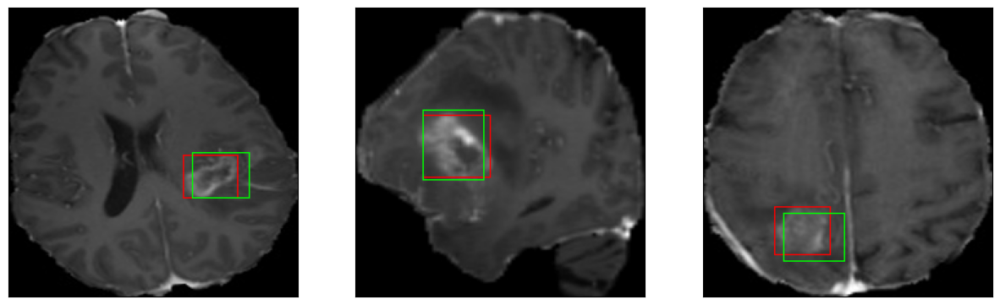

52/52 [==============================] - 20s 380ms/step - loss: 9.1307 - IoU: 0.4437 - val_loss: 10.8677 - val_IoU: 0.5652
Epoch 77/100
52/52 [==============================] - ETA: 0s - loss: 8.6661 - IoU: 0.4562
Epoch 77: val_IoU improved from 0.59287 to 0.61021, saving model to ./model_checkpoint_RESNET/model_RESNET.h5
8/8 [==============================] - 1s 143ms/step


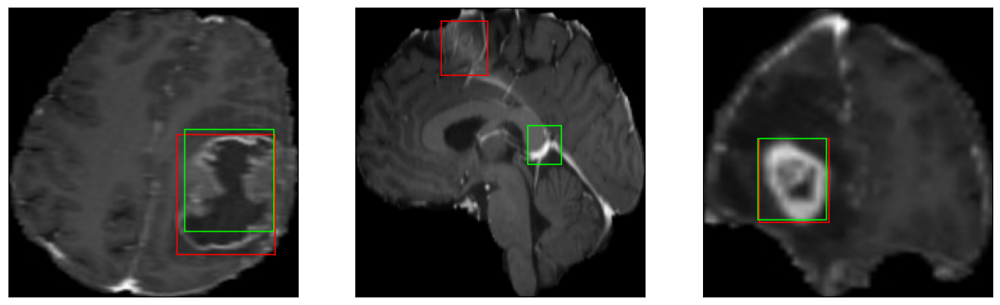

52/52 [==============================] - 24s 468ms/step - loss: 8.6661 - IoU: 0.4562 - val_loss: 7.5775 - val_IoU: 0.6102
Epoch 78/100
52/52 [==============================] - ETA: 0s - loss: 9.2029 - IoU: 0.4327
Epoch 78: val_IoU did not improve from 0.61021
8/8 [==============================] - 1s 144ms/step


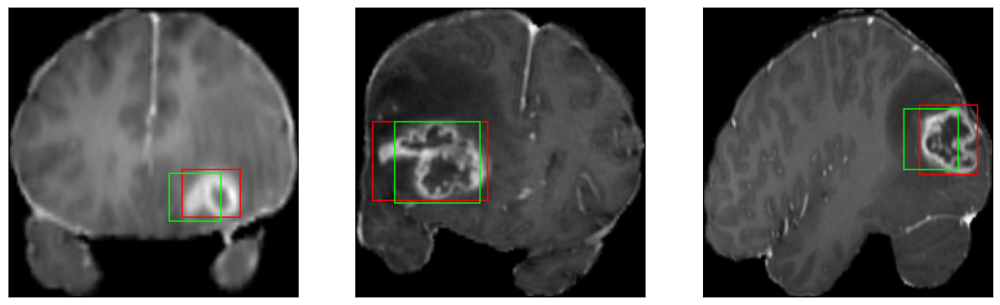

52/52 [==============================] - 20s 381ms/step - loss: 9.2029 - IoU: 0.4327 - val_loss: 8.9125 - val_IoU: 0.5316
Epoch 79/100
52/52 [==============================] - ETA: 0s - loss: 8.8856 - IoU: 0.4454
Epoch 79: val_IoU did not improve from 0.61021
8/8 [==============================] - 1s 144ms/step


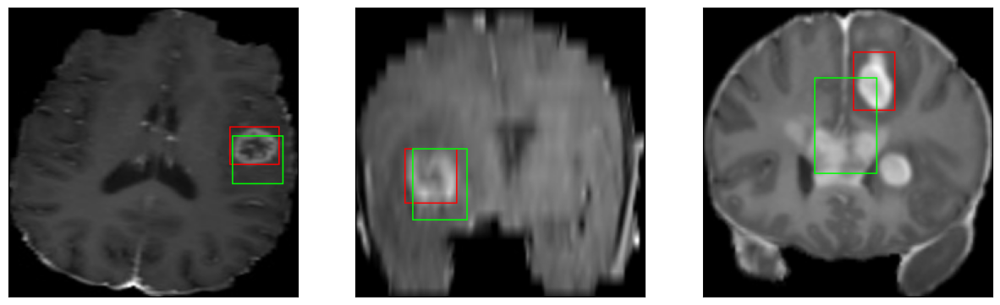

52/52 [==============================] - 19s 373ms/step - loss: 8.8856 - IoU: 0.4454 - val_loss: 10.2432 - val_IoU: 0.4743
Epoch 80/100
52/52 [==============================] - ETA: 0s - loss: 9.0867 - IoU: 0.4458
Epoch 80: val_IoU did not improve from 0.61021
8/8 [==============================] - 1s 145ms/step


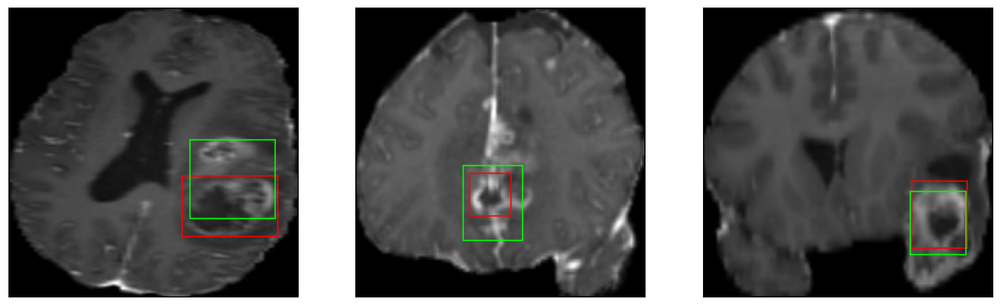

52/52 [==============================] - 20s 384ms/step - loss: 9.0867 - IoU: 0.4458 - val_loss: 8.7676 - val_IoU: 0.5728
Epoch 81/100
52/52 [==============================] - ETA: 0s - loss: 9.1511 - IoU: 0.4446
Epoch 81: val_IoU did not improve from 0.61021
8/8 [==============================] - 1s 145ms/step


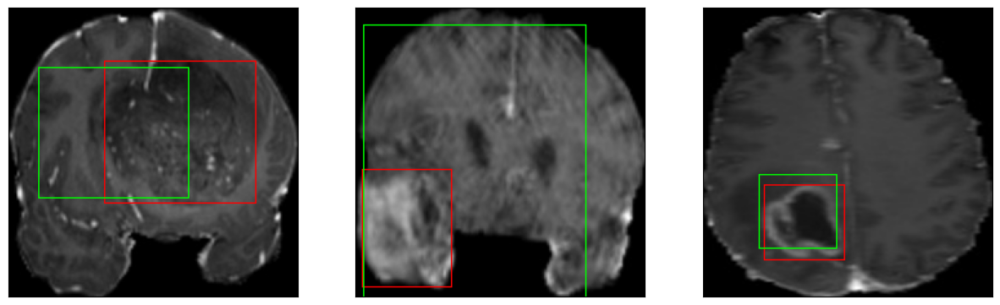

52/52 [==============================] - 19s 373ms/step - loss: 9.1511 - IoU: 0.4446 - val_loss: 42.3046 - val_IoU: 0.2876
Epoch 82/100
52/52 [==============================] - ETA: 0s - loss: 9.0018 - IoU: 0.4510
Epoch 82: val_IoU did not improve from 0.61021
8/8 [==============================] - 1s 143ms/step


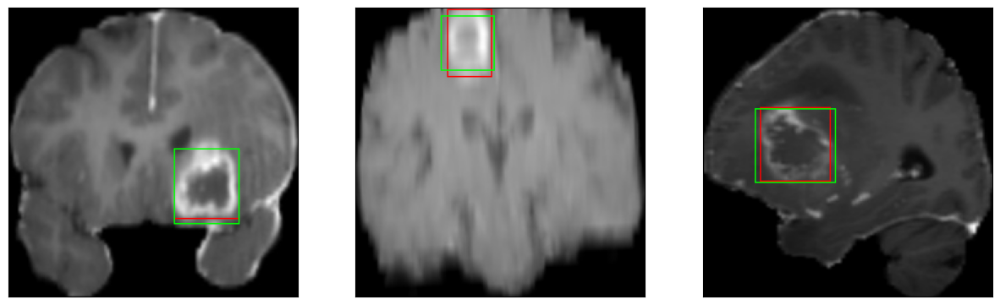

52/52 [==============================] - 20s 380ms/step - loss: 9.0018 - IoU: 0.4510 - val_loss: 8.3967 - val_IoU: 0.5916
Epoch 83/100
52/52 [==============================] - ETA: 0s - loss: 8.9560 - IoU: 0.4408
Epoch 83: val_IoU did not improve from 0.61021
8/8 [==============================] - 1s 144ms/step


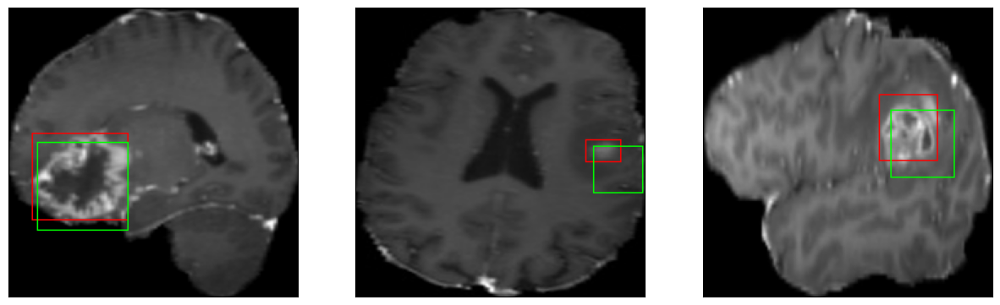

52/52 [==============================] - 20s 382ms/step - loss: 8.9560 - IoU: 0.4408 - val_loss: 10.4939 - val_IoU: 0.4460
Epoch 84/100
52/52 [==============================] - ETA: 0s - loss: 8.9224 - IoU: 0.4519
Epoch 84: val_IoU did not improve from 0.61021
8/8 [==============================] - 1s 144ms/step


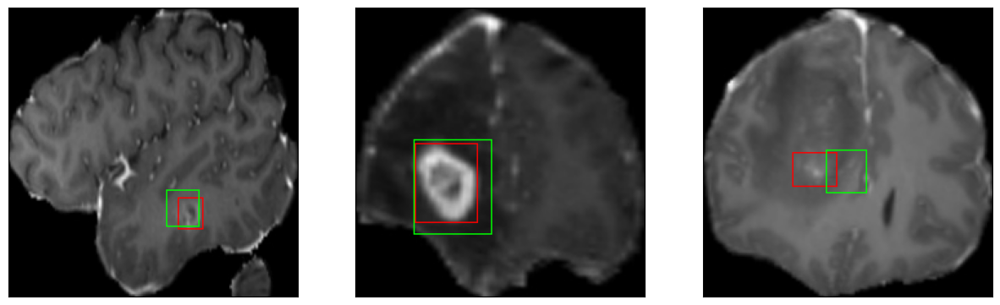

52/52 [==============================] - 20s 378ms/step - loss: 8.9224 - IoU: 0.4519 - val_loss: 9.2612 - val_IoU: 0.5113
Epoch 85/100
52/52 [==============================] - ETA: 0s - loss: 9.1365 - IoU: 0.4474
Epoch 85: val_IoU did not improve from 0.61021
8/8 [==============================] - 1s 142ms/step


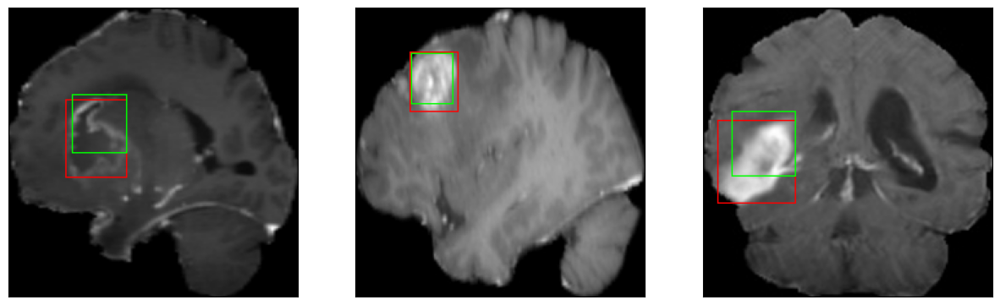

52/52 [==============================] - 20s 395ms/step - loss: 9.1365 - IoU: 0.4474 - val_loss: 10.8110 - val_IoU: 0.4564
Epoch 86/100
52/52 [==============================] - ETA: 0s - loss: 8.8314 - IoU: 0.4552
Epoch 86: val_IoU did not improve from 0.61021
8/8 [==============================] - 1s 144ms/step


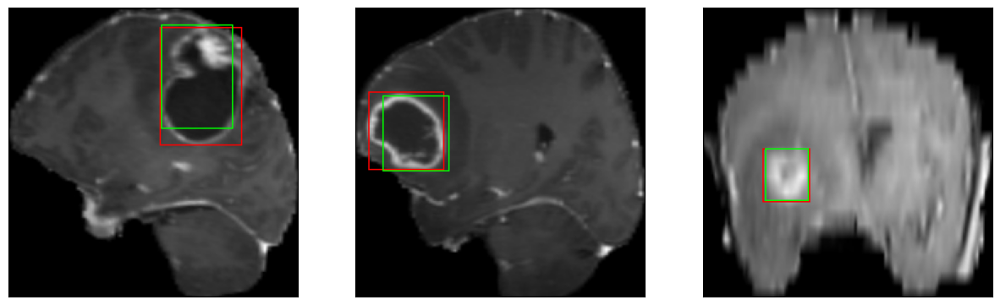

52/52 [==============================] - 19s 376ms/step - loss: 8.8314 - IoU: 0.4552 - val_loss: 9.8130 - val_IoU: 0.5083
Epoch 87/100
52/52 [==============================] - ETA: 0s - loss: 8.6980 - IoU: 0.4499
Epoch 87: val_IoU did not improve from 0.61021
8/8 [==============================] - 1s 146ms/step


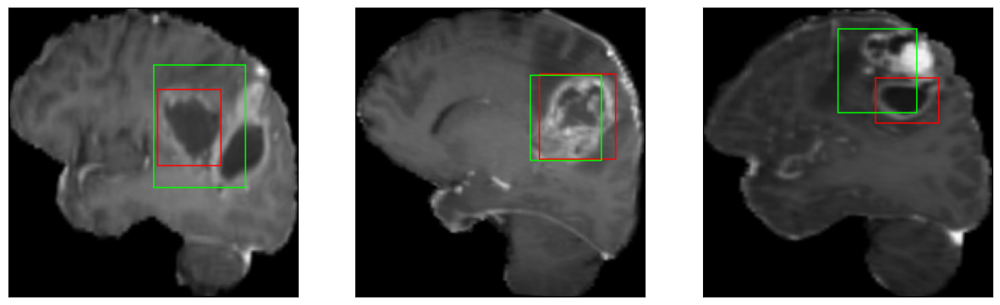

52/52 [==============================] - 20s 378ms/step - loss: 8.6980 - IoU: 0.4499 - val_loss: 7.6546 - val_IoU: 0.6002
Epoch 88/100
52/52 [==============================] - ETA: 0s - loss: 8.4995 - IoU: 0.4617
Epoch 88: val_IoU improved from 0.61021 to 0.62071, saving model to ./model_checkpoint_RESNET/model_RESNET.h5
8/8 [==============================] - 1s 142ms/step


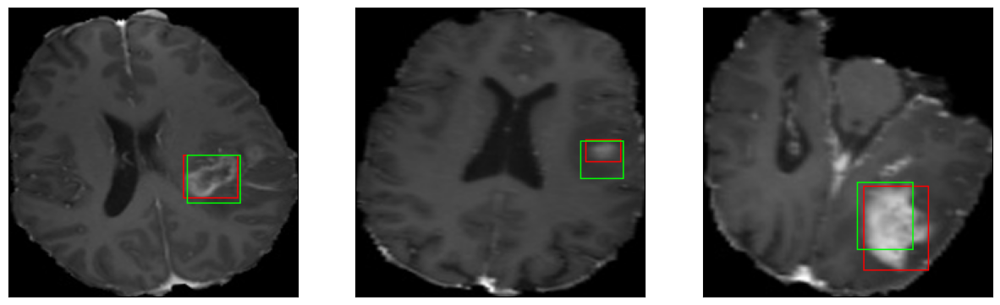

52/52 [==============================] - 26s 509ms/step - loss: 8.4995 - IoU: 0.4617 - val_loss: 7.4705 - val_IoU: 0.6207
Epoch 89/100
52/52 [==============================] - ETA: 0s - loss: 8.7053 - IoU: 0.4519
Epoch 89: val_IoU did not improve from 0.62071
8/8 [==============================] - 1s 143ms/step


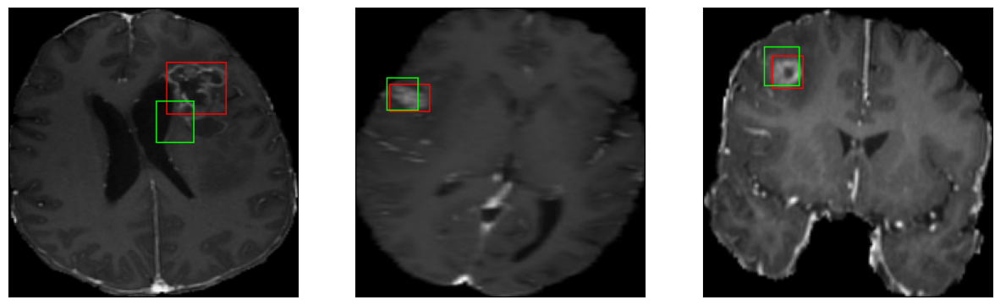

52/52 [==============================] - 20s 379ms/step - loss: 8.7053 - IoU: 0.4519 - val_loss: 8.3770 - val_IoU: 0.5514
Epoch 90/100
52/52 [==============================] - ETA: 0s - loss: 8.6813 - IoU: 0.4559
Epoch 90: val_IoU did not improve from 0.62071
8/8 [==============================] - 1s 143ms/step


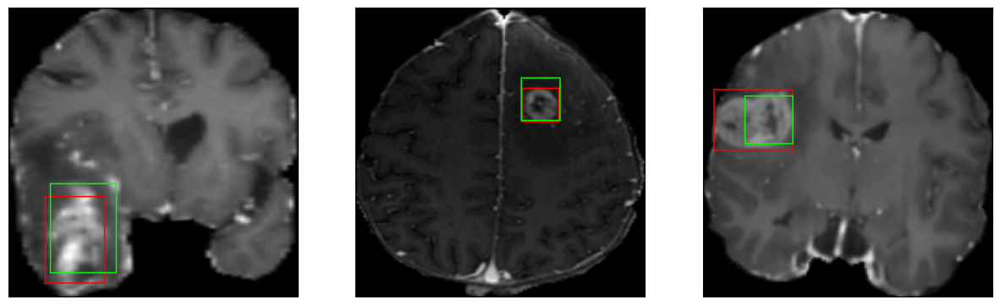

52/52 [==============================] - 20s 379ms/step - loss: 8.6813 - IoU: 0.4559 - val_loss: 8.7276 - val_IoU: 0.5513
Epoch 91/100
52/52 [==============================] - ETA: 0s - loss: 8.7943 - IoU: 0.4495
Epoch 91: val_IoU did not improve from 0.62071
8/8 [==============================] - 1s 143ms/step


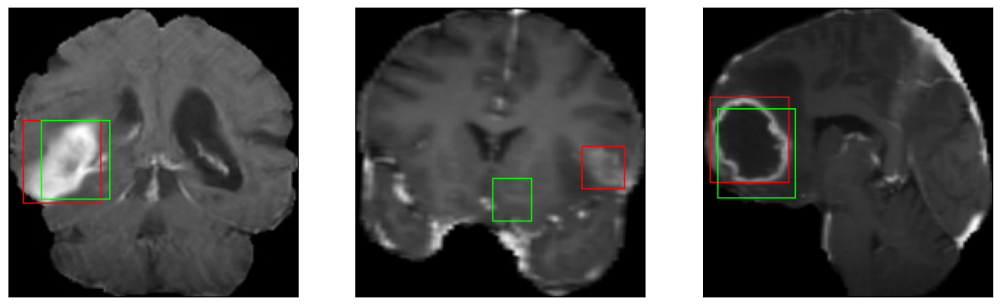

52/52 [==============================] - 19s 372ms/step - loss: 8.7943 - IoU: 0.4495 - val_loss: 10.3539 - val_IoU: 0.5407
Epoch 92/100
52/52 [==============================] - ETA: 0s - loss: 8.9658 - IoU: 0.4525
Epoch 92: val_IoU did not improve from 0.62071
8/8 [==============================] - 1s 144ms/step


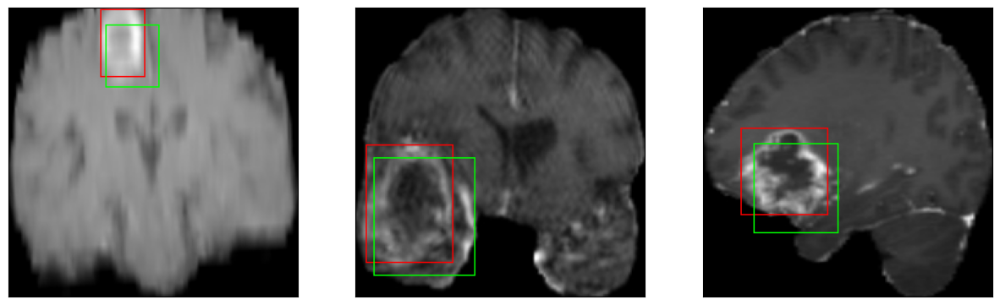

52/52 [==============================] - 19s 376ms/step - loss: 8.9658 - IoU: 0.4525 - val_loss: 11.5150 - val_IoU: 0.3923
Epoch 93/100
52/52 [==============================] - ETA: 0s - loss: 8.8364 - IoU: 0.4507
Epoch 93: val_IoU did not improve from 0.62071
8/8 [==============================] - 1s 144ms/step


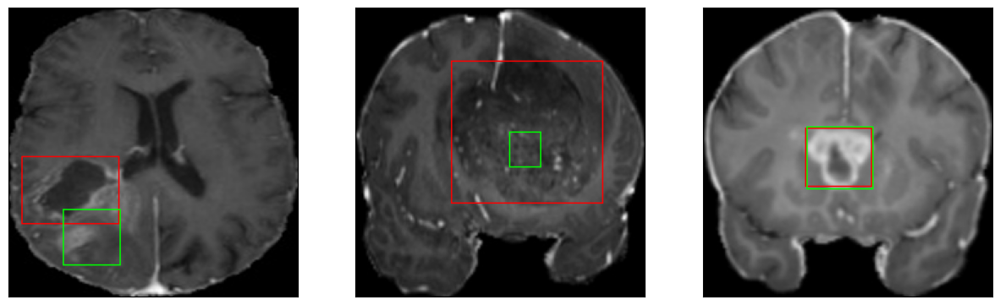

52/52 [==============================] - 19s 370ms/step - loss: 8.8364 - IoU: 0.4507 - val_loss: 8.0987 - val_IoU: 0.5618
Epoch 94/100
52/52 [==============================] - ETA: 0s - loss: 8.3244 - IoU: 0.4680
Epoch 94: val_IoU did not improve from 0.62071
8/8 [==============================] - 1s 145ms/step


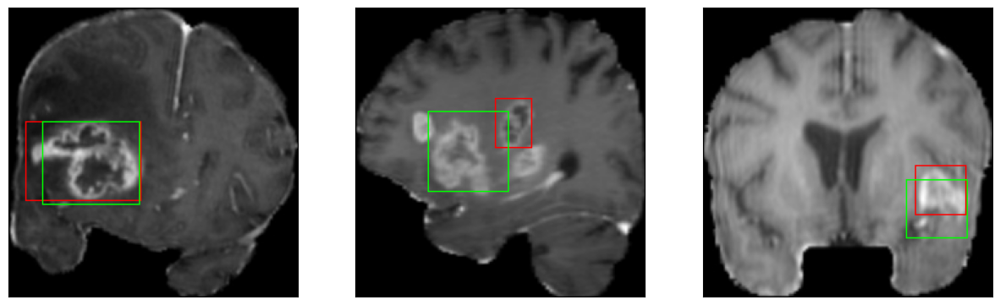

52/52 [==============================] - 19s 376ms/step - loss: 8.3244 - IoU: 0.4680 - val_loss: 8.3726 - val_IoU: 0.5737
Epoch 95/100
52/52 [==============================] - ETA: 0s - loss: 8.4456 - IoU: 0.4614
Epoch 95: val_IoU did not improve from 0.62071
8/8 [==============================] - 1s 144ms/step


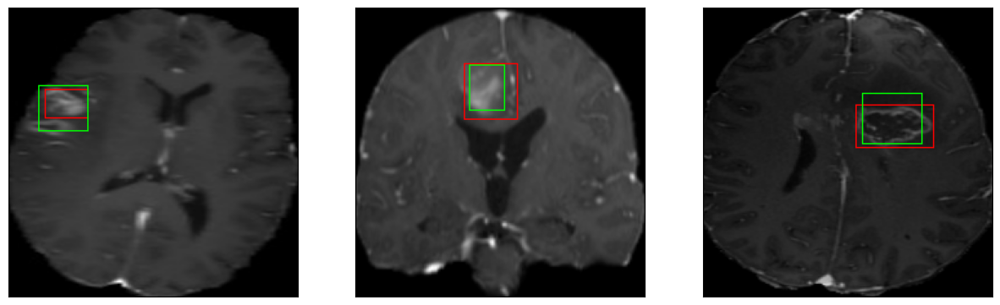

52/52 [==============================] - 20s 384ms/step - loss: 8.4456 - IoU: 0.4614 - val_loss: 7.9627 - val_IoU: 0.5832
Epoch 96/100
52/52 [==============================] - ETA: 0s - loss: 8.9319 - IoU: 0.4494
Epoch 96: val_IoU did not improve from 0.62071
8/8 [==============================] - 1s 144ms/step


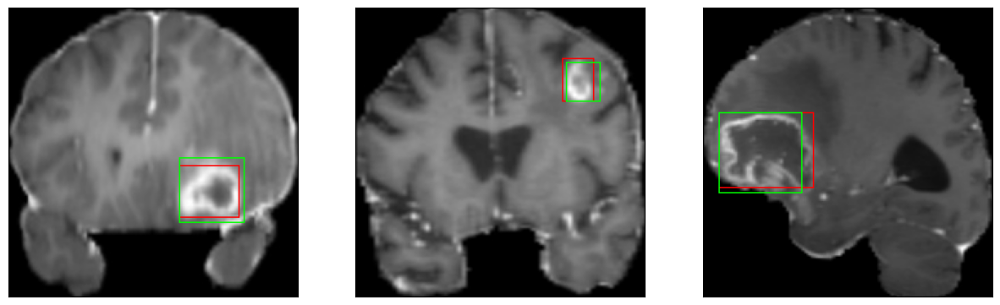

52/52 [==============================] - 20s 381ms/step - loss: 8.9319 - IoU: 0.4494 - val_loss: 8.2550 - val_IoU: 0.6083
Epoch 97/100
52/52 [==============================] - ETA: 0s - loss: 8.3228 - IoU: 0.4578
Epoch 97: val_IoU did not improve from 0.62071
8/8 [==============================] - 1s 142ms/step


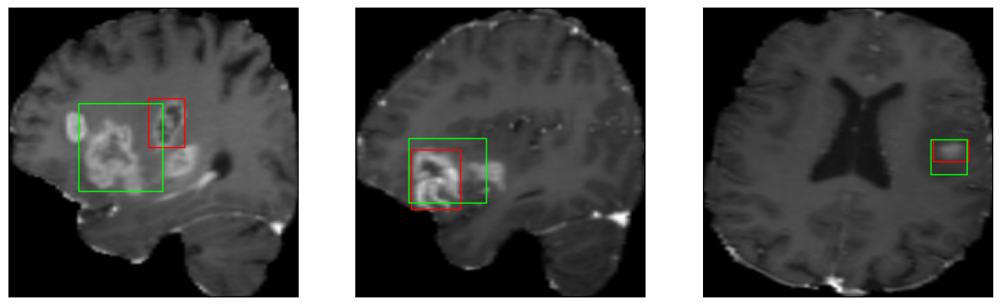

52/52 [==============================] - 20s 382ms/step - loss: 8.3228 - IoU: 0.4578 - val_loss: 7.6595 - val_IoU: 0.5916
Epoch 98/100
52/52 [==============================] - ETA: 0s - loss: 8.5914 - IoU: 0.4544
Epoch 98: val_IoU did not improve from 0.62071
8/8 [==============================] - 1s 144ms/step


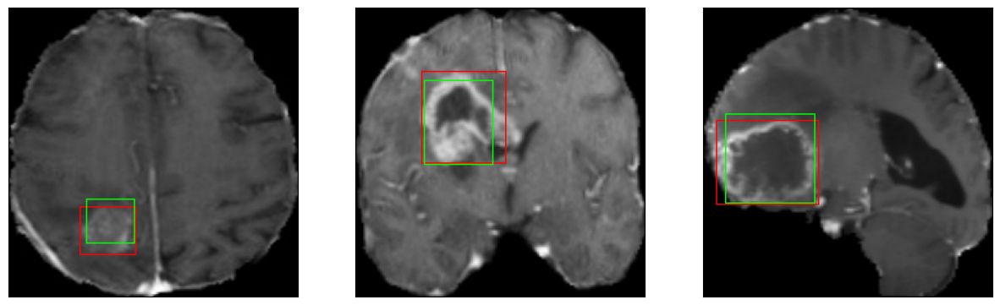

52/52 [==============================] - 20s 380ms/step - loss: 8.5914 - IoU: 0.4544 - val_loss: 8.9828 - val_IoU: 0.5288
Epoch 99/100
52/52 [==============================] - ETA: 0s - loss: 8.5837 - IoU: 0.4568
Epoch 99: val_IoU did not improve from 0.62071
8/8 [==============================] - 1s 143ms/step


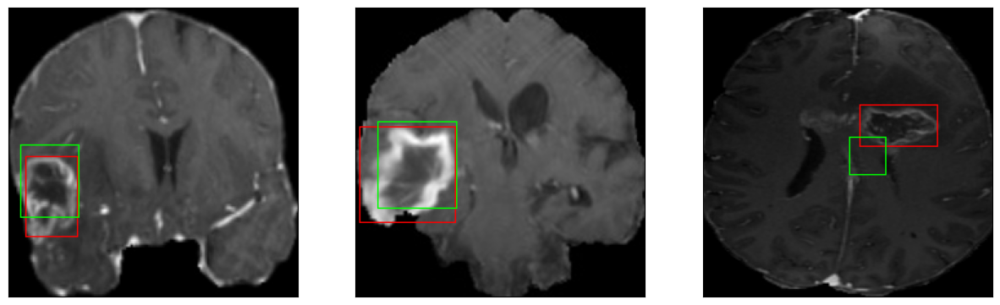

52/52 [==============================] - 19s 376ms/step - loss: 8.5837 - IoU: 0.4568 - val_loss: 7.7811 - val_IoU: 0.5704
Epoch 100/100
52/52 [==============================] - ETA: 0s - loss: 8.4152 - IoU: 0.4605
Epoch 100: val_IoU did not improve from 0.62071
8/8 [==============================] - 1s 143ms/step


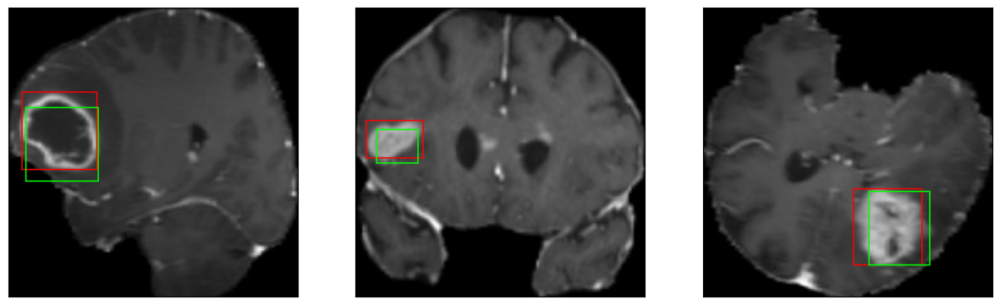

52/52 [==============================] - 19s 376ms/step - loss: 8.4152 - IoU: 0.4605 - val_loss: 8.2339 - val_IoU: 0.5543


In [ ]:
#Model fitting
hist = model.fit(
        train_dataset,
        epochs=100,
        validation_data = val_dataset,
        callbacks = callbacks_list
        )

In [37]:
import seaborn as sns
colors_dark = ["#1F1F1F", "#313131", '#636363', '#AEAEAE', '#DADADA']
colors_red = ["#331313", "#582626", '#9E1717', '#D35151', '#E9B4B4']
colors_green = ['#01411C','#4B6F44','#4F7942','#74C365','#D0F0C0']


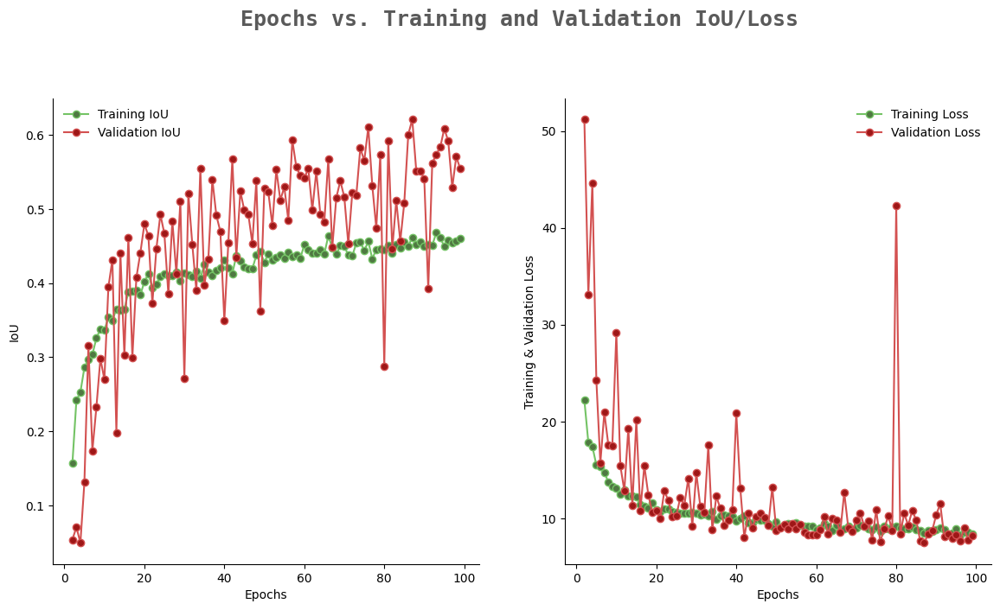

In [ ]:
#History plot
from warnings import filterwarnings
filterwarnings('ignore')

epochs = [i for i in range(2,100)]
fig, ax = plt.subplots(1,2,figsize=(14,7))
train_acc = hist.history['IoU']
train_loss = hist.history['loss']
val_acc = hist.history['val_IoU']
val_loss = hist.history['val_loss']

fig.text(s='Epochs vs. Training and Validation IoU/Loss',size=18,fontweight='bold',
             fontname='monospace',color=colors_dark[1],y=1,x=0.28,alpha=0.8)

sns.despine()
ax[0].plot(epochs, train_acc[2:100], marker='o',markerfacecolor=colors_green[2],color=colors_green[3],
           label = 'Training IoU')
ax[0].plot(epochs, val_acc[2:100], marker='o',markerfacecolor=colors_red[2],color=colors_red[3],
           label = 'Validation IoU')
ax[0].legend(frameon=False)
ax[0].set_xlabel('Epochs')
ax[0].set_ylabel('IoU')

sns.despine()
ax[1].plot(epochs, train_loss[2:100], marker='o',markerfacecolor=colors_green[2],color=colors_green[3],
           label ='Training Loss')
ax[1].plot(epochs, val_loss[2:100], marker='o',markerfacecolor=colors_red[2],color=colors_red[3],
           label = 'Validation Loss')
ax[1].legend(frameon=False)
ax[1].set_xlabel('Epochs')
ax[1].set_ylabel('Training & Validation Loss')

fig.show()

In [40]:
%cd '../content/drive/MyDrive'

/content/drive/MyDrive


In [42]:
#Load the model with better results
model = tf.keras.models.load_model('./model_checkpoint_RESNET/model_RESNET.h5', compile=False)

In [43]:
model.compile(
    loss={
        'bb_pred': 'mae'
    },
    optimizer=tf.keras.optimizers.Adam(1e-3),
    metrics=[IoU]
    
)

In [45]:
#Model evaluation in Loss and IoU for the test_dataset
model.evaluate(test_dataset)

15/15 [==============================] - 2s 100ms/step - loss: 8.5914 - IoU: 0.5809


[8.591439247131348, 0.5808645486831665]

In [ ]:
#Model evaluation in Loss and IoU for the val_dataset
model.evaluate(val_dataset)

6/6 [==============================] - 1s 90ms/step - loss: 7.4705 - IoU: 0.6220


[7.470474720001221, 0.621986985206604]

In [ ]:
#Model evaluation in Loss and IoU for the train_dataset
model.evaluate(train_dataset)

52/52 [==============================] - 5s 90ms/step - loss: 4.7814 - IoU: 0.6714


[4.78143835067749, 0.6713771224021912]